<h1>Actin Simulation Grinding Velocity Analysis</h1>

&#9676;
`General change in leading tip grinding data, as specie ratio changes (before and after filter z <= 0.12 uM):`

In [64]:
# prepared by Sam. -- Prof. Nitta Lab.
%run preparation.py
%matplotlib inline

Conf0.1 shape before filter:  (301, 4)
Conf0.1 shape after filter:  (301, 4)
Conf0.15 shape before filter:  (301, 4)
Conf0.15 shape after filter:  (301, 4)
Conf0.2 shape before filter:  (301, 4)
Conf0.2 shape after filter:  (301, 4)
Conf0.25 shape before filter:  (301, 4)
Conf0.25 shape after filter:  (301, 4)
Conf0.3 shape before filter:  (301, 4)
Conf0.3 shape after filter:  (41, 4)
Conf0.35 shape before filter:  (301, 4)
Conf0.35 shape after filter:  (67, 4)
Conf0.4 shape before filter:  (301, 4)
Conf0.4 shape after filter:  (82, 4)
Conf0.45 shape before filter:  (301, 4)
Conf0.45 shape after filter:  (61, 4)
Conf0.5 shape before filter:  (301, 4)
Conf0.5 shape after filter:  (44, 4)
Conf0.55 shape before filter:  (301, 4)
Conf0.55 shape after filter:  (155, 4)
Conf0.6 shape before filter:  (301, 4)
Conf0.6 shape after filter:  (254, 4)
Conf0.65 shape before filter:  (301, 4)
Conf0.65 shape after filter:  (280, 4)
Conf0.7 shape before filter:  (301, 4)
Conf0.7 shape after filter:  (

&#9676; 
`Output while skipping rows [R0.10B13ATP2000MD3000]:`

In [65]:
columns = ['time', 'x_tip', 'y_tip']
df_load = pd.read_csv('TipXY_A001_r0.1.txt', names=columns, delim_whitespace=True)
df_nice = df_load.drop(['time'], axis=1)
df = df_nice.iloc[0::10, :]
df.to_csv('SkippedTipXY_A001.csv', encoding='utf-8', index=False)

In [66]:
Dx_tip = np.diff(df['x_tip']); Dy_tip = np.diff(df['y_tip'])
DD=np.sqrt((Dx_tip**2)+(Dy_tip**2))
np.savetxt('DD_A001.csv', DD, delimiter=',')
v=DD/(10*dt); Av_vel = np.mean(v)
np.savetxt('v.csv', v, delimiter=',')
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

Ave_vel: 0.11145858362603829
VSD: 0.05837139284648545


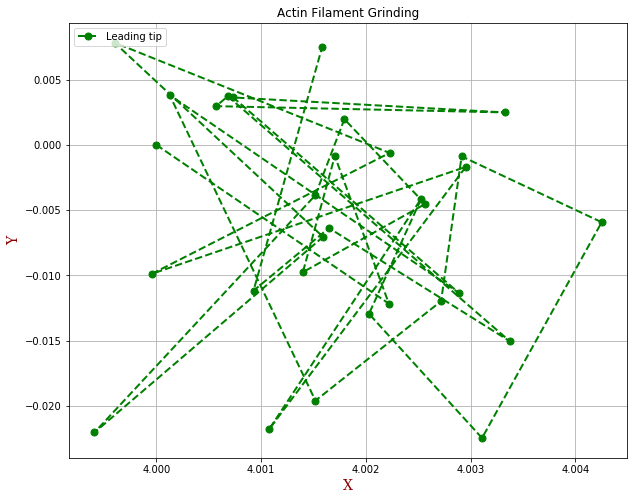

In [67]:
plt.figure(figsize=(10,8))
#plt.text(6, 8, 'Av_Vel = ', fontdict=font); plt.text(8, 8, '%.5f'%Av_vel, fontdict=font)
#plt.text(6, 7, 'Vel_SD = ', fontdict=font); plt.text(8, 7, '%.5f'%vSD, fontdict=font)
plt.plot(df['x_tip'],df['y_tip'], label='Leading tip', color='green', marker='o', \
         linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Grinding'); plt.legend(loc='upper left'); plt.grid()
#plt.savefig('actin_graph.svg', format='svg', dpi=1200)
print(colored('Ave_vel:', 'yellow', attrs=['reverse', 'blink']), \
      colored(Av_vel, 'yellow', attrs=['reverse', 'blink']))
print(colored('VSD:', 'yellow', attrs=['reverse', 'blink']), \
      colored(vSD, 'yellow', attrs=['reverse', 'blink']))

&#9676; 
`For clarity, the above output is as a result of skipping every 10 rows.
However, it may not be the best representation of the **average** grinding velocity.
In the following analysis, all leading tip datasets are included except if z is > 0.12 uM`

### Output while only considering the grinding velocity: <br>$0 \leq$ filament z-attach limit $\leq 0.12 \mu$ M

&#9676; 
`Leading tip grinding analysis for R0.10B13ATP2000MD3000:`

Ave_vel: 0.9264735240450269
VSD: 0.6265233020031812


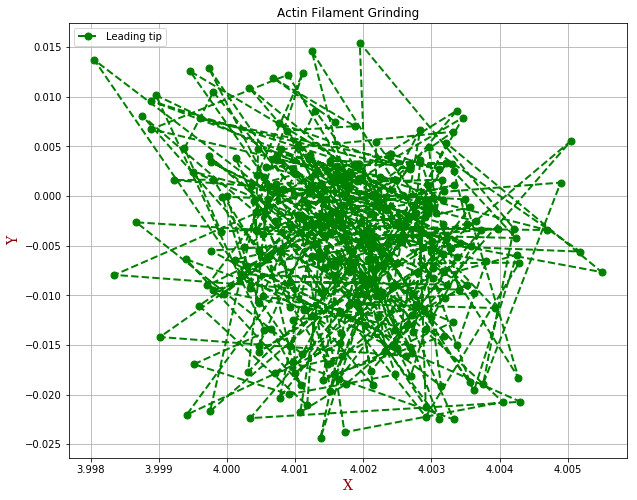

In [68]:
index_diff01 = np.diff(df01.index) # difference in index between one row and next
Dx = np.diff(df01['x']); Dy = np.diff(df01['y']) # value difference between one row and next
DD=np.sqrt((Dx**2)+(Dy**2)) # calculate distance 
v=DD/(index_diff01*dt); Av_vel = np.mean(v) # calculate velocity and mean
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD) # calculate standard deviation

plt.figure(figsize=(10,8))
plt.plot(df01['x'],df01['y'], label='Leading tip', color='green', marker='o', \
         linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Grinding'); plt.legend(loc='upper left'); plt.grid()
print(colored('Ave_vel:', 'yellow', attrs=['reverse', 'blink']), \
      colored(Av_vel, 'yellow', attrs=['reverse', 'blink']))
print(colored('VSD:', 'yellow', attrs=['reverse', 'blink']), \
      colored(vSD, 'yellow', attrs=['reverse', 'blink']))

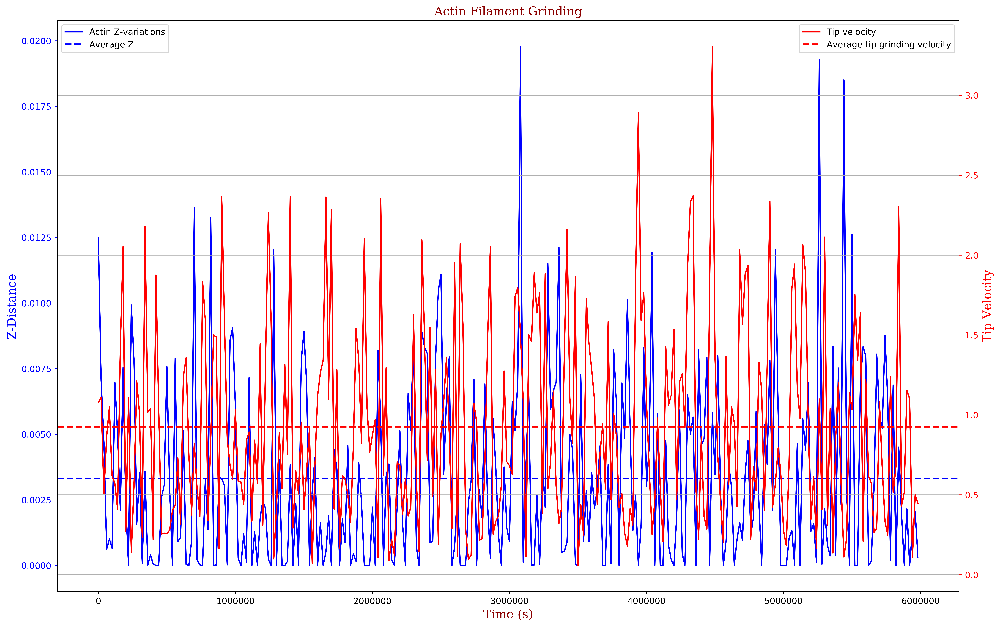

In [69]:
df01_ = df01.drop(df01.index[300]) # drop the last row to match vel shape
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df01_['time'],df01_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df01_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df01_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

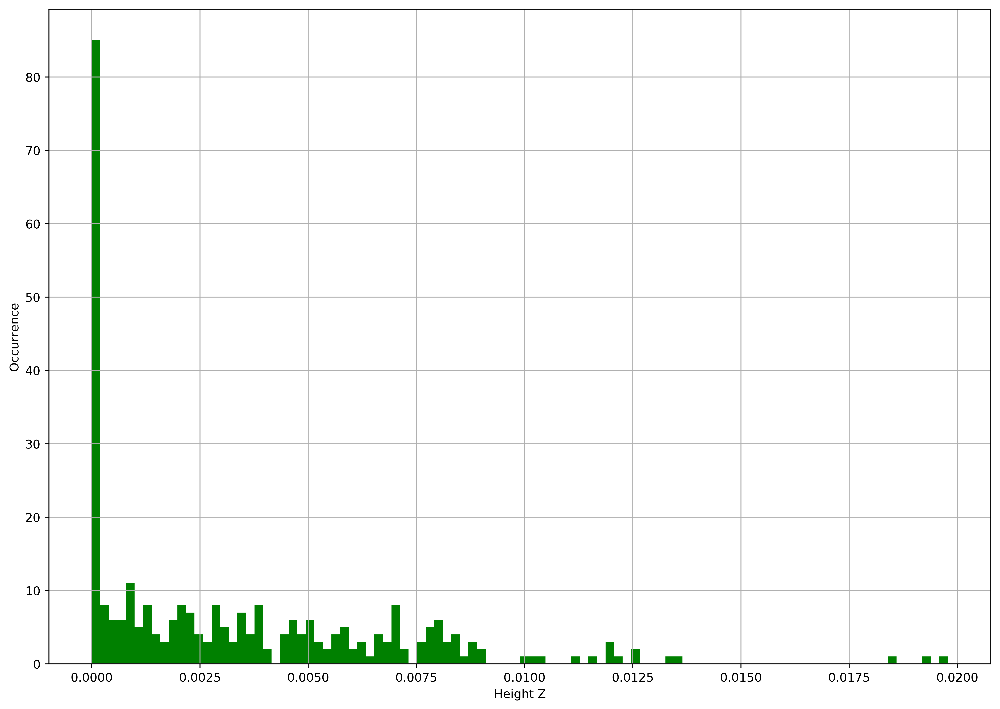

In [70]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df01['z'].hist(bins=100, ax=ax, color='green')

&#9676; 
`Leading tip grinding analysis for R0.15B13ATP2000MD3000:`

Ave_vel: 3.406924525719324
VSD: 2.7961853675313817


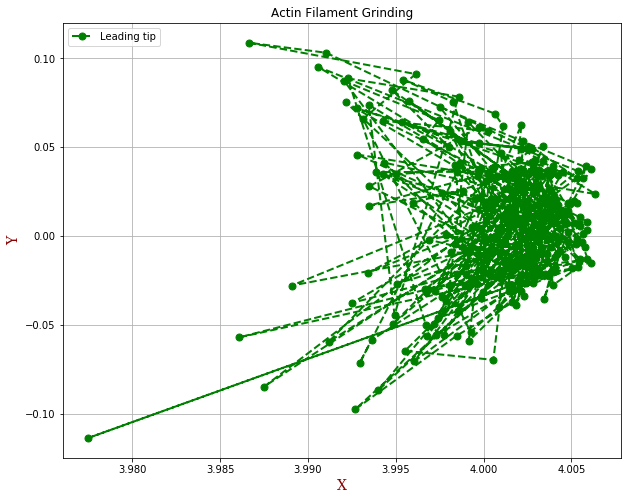

In [71]:
index_diff015 = np.diff(df015.index) 
Dx = np.diff(df015['x']); Dy = np.diff(df015['y']) 
DD=np.sqrt((Dx**2)+(Dy**2)) 
v=DD/(index_diff015*dt); Av_vel = np.mean(v) 
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD) 

plt.figure(figsize=(10,8))
plt.plot(df015['x'],df015['y'], label='Leading tip', color='green', marker='o', \
         linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Grinding'); plt.legend(loc='upper left'); plt.grid()
print(colored('Ave_vel:', 'yellow', attrs=['reverse', 'blink']), \
      colored(Av_vel, 'yellow', attrs=['reverse', 'blink']))
print(colored('VSD:', 'yellow', attrs=['reverse', 'blink']), \
      colored(vSD, 'yellow', attrs=['reverse', 'blink']))

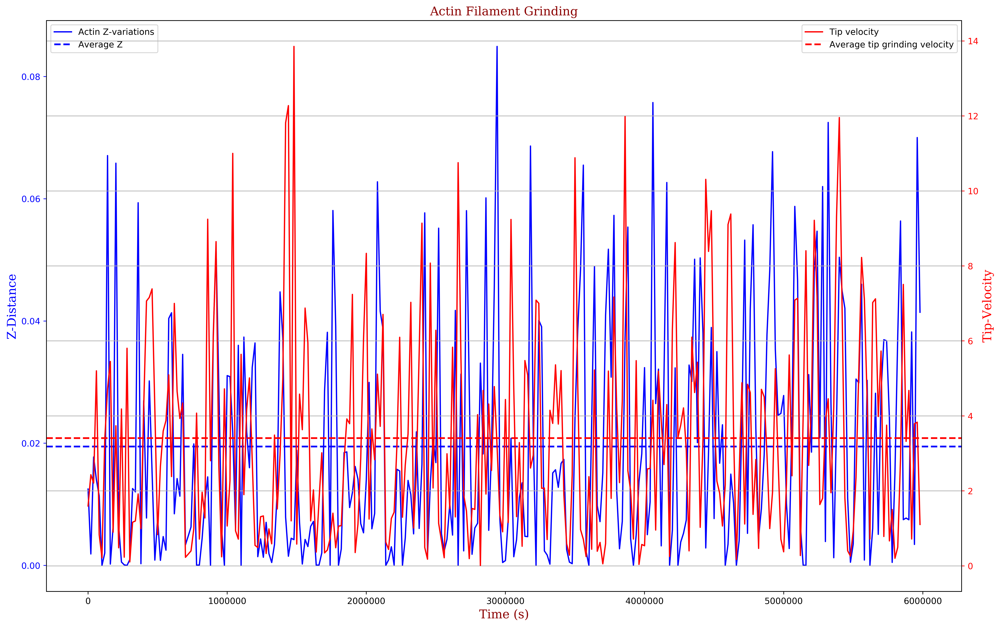

In [72]:
df015_ = df015.drop(df015.index[300]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df015_['time'],df015_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df015_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df015_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

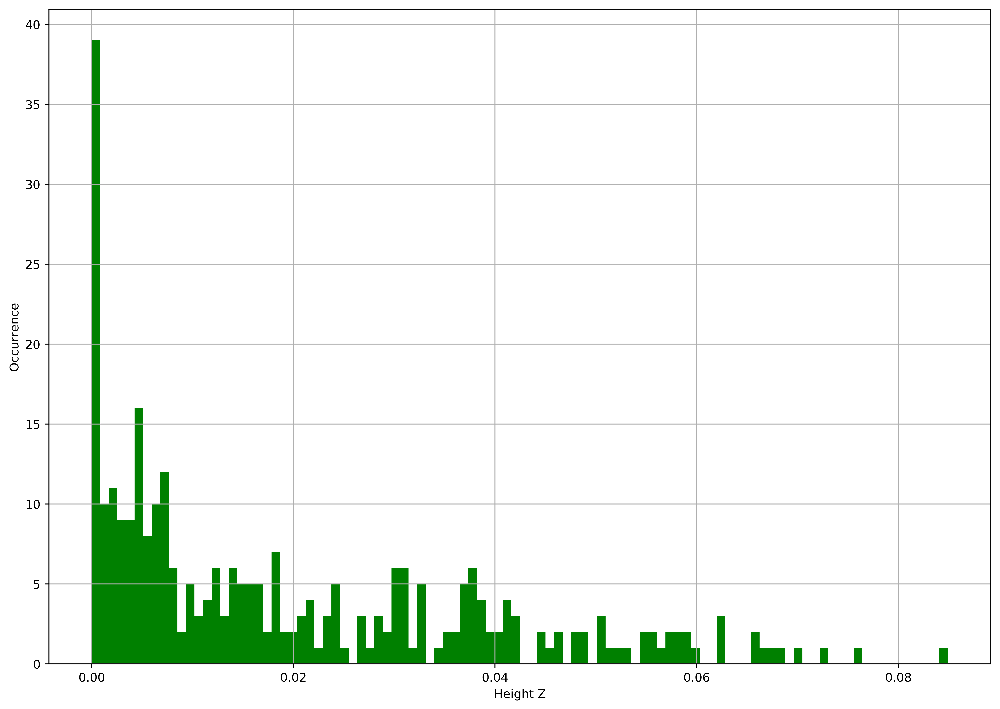

In [73]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df015['z'].hist(bins=100, ax=ax, color='green')

&#9676; 
`Leading tip grinding analysis for R0.20B13ATP2000MD3000:`

Ave_vel: 3.216799964173127
VSD: 3.0764013170929148


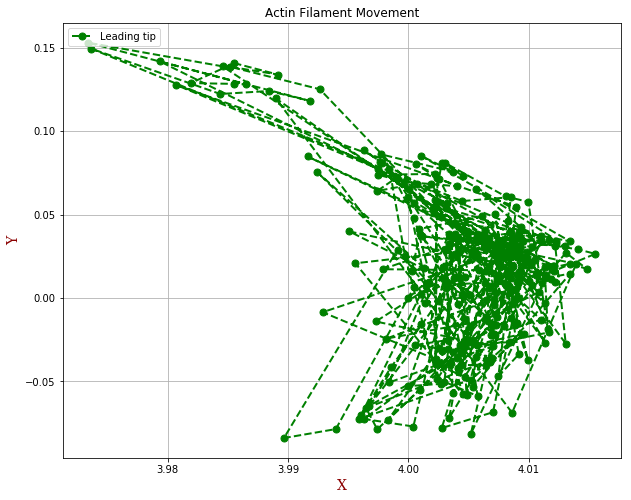

In [74]:
index_diff02 = np.diff(df02.index)
Dx = np.diff(df02['x']); Dy = np.diff(df02['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff02*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df02['x'],df02['y'], label='Leading tip', color='green', marker='o', \
         linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print(colored('Ave_vel:', 'yellow', attrs=['reverse', 'blink']), \
      colored(Av_vel, 'yellow', attrs=['reverse', 'blink']))
print(colored('VSD:', 'yellow', attrs=['reverse', 'blink']), \
      colored(vSD, 'yellow', attrs=['reverse', 'blink']))

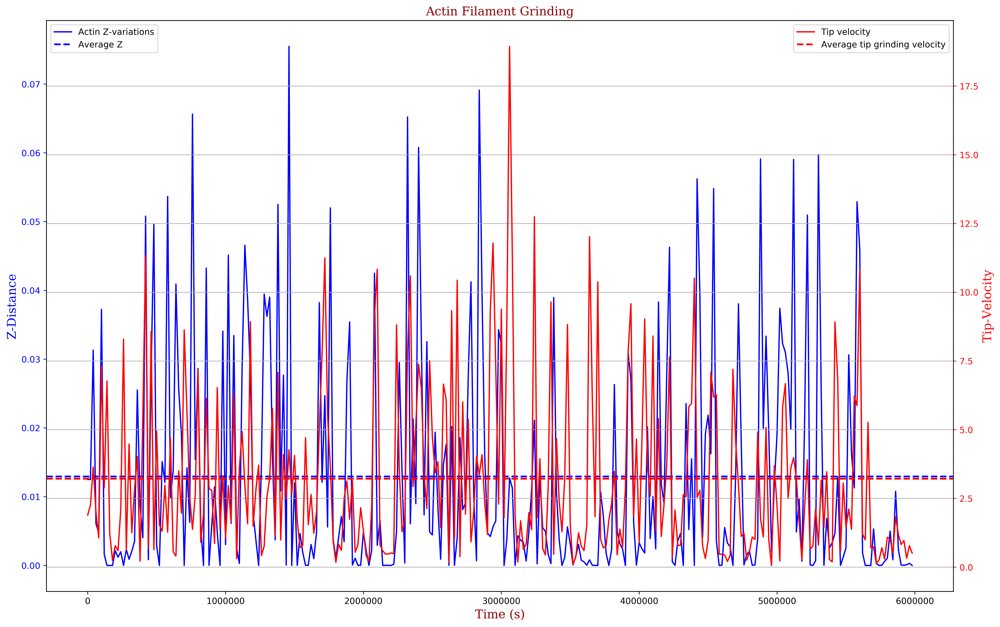

In [75]:
df02_ = df02.drop(df02.index[300])
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df02_['time'],df02_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df02_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df02_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

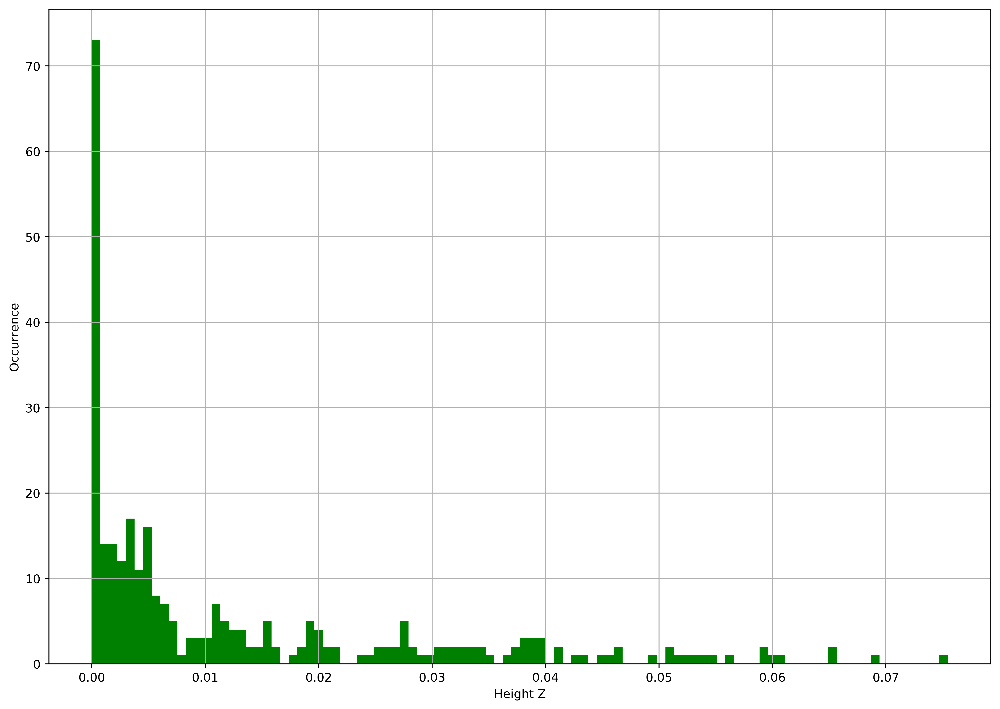

In [76]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df02['z'].hist(bins=100, ax=ax, color='green')

&#9676; 
`Leading tip grinding analysis for R0.25B13ATP2000MD3000:`

Ave_vel: 1.0884400487231294
VSD: 0.8404796977848611


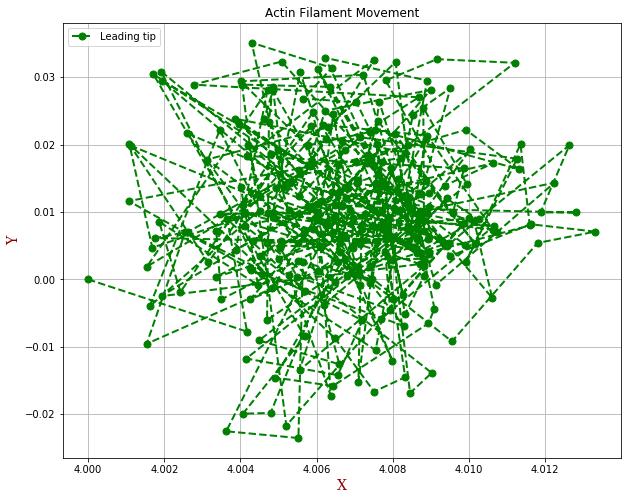

In [77]:
index_diff025 = np.diff(df025.index)
Dx = np.diff(df025['x']); Dy = np.diff(df025['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff025*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df025['x'],df025['y'], label='Leading tip', color='green', marker='o', \
         linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print(colored('Ave_vel:', 'yellow', attrs=['reverse', 'blink']), \
      colored(Av_vel, 'yellow', attrs=['reverse', 'blink']))
print(colored('VSD:', 'yellow', attrs=['reverse', 'blink']), \
      colored(vSD, 'yellow', attrs=['reverse', 'blink']))

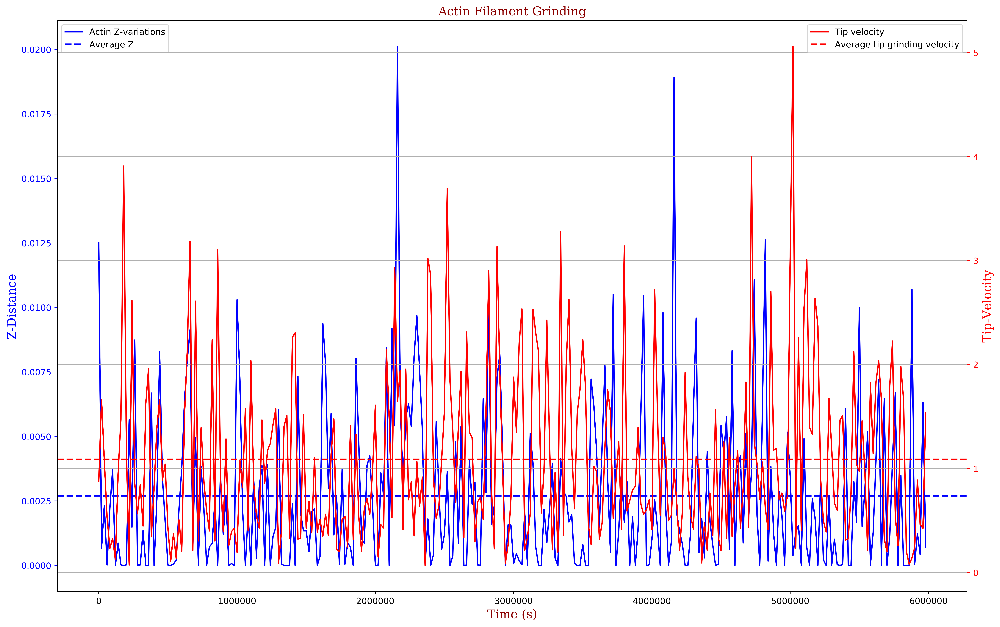

In [78]:
df025_ = df025.drop(df025.index[300])
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df025_['time'],df025_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df025_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df025_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

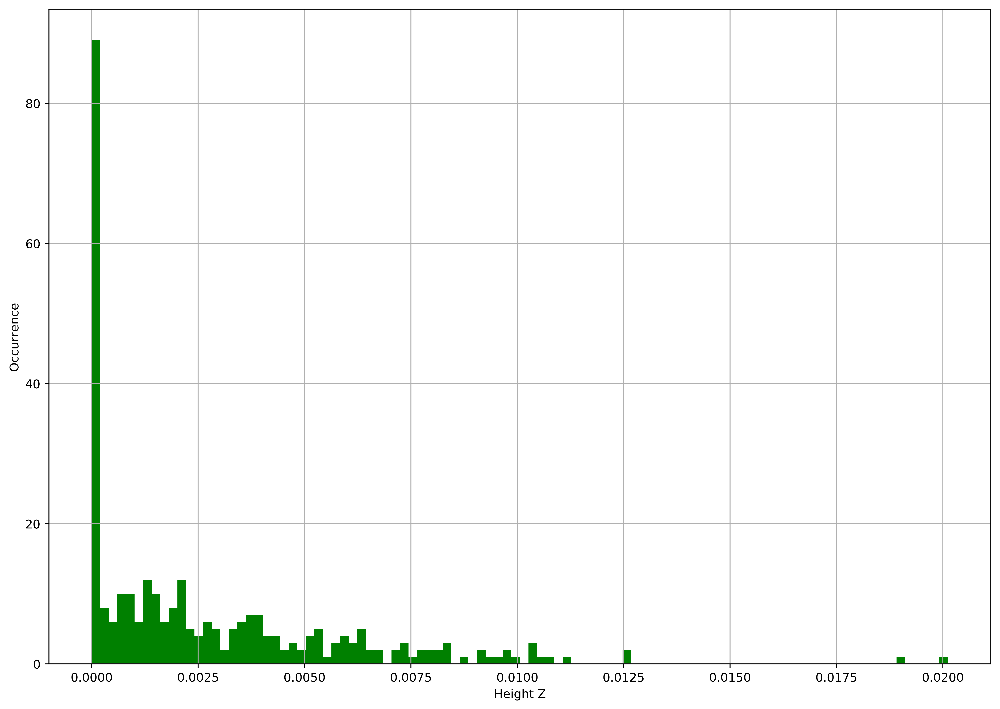

In [79]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df025['z'].hist(bins=100, ax=ax, color='green')

&#9676; 
`Leading tip grinding analysis for R0.30B13ATP2000MD3000:`

Ave_vel: 9.50190705925856
VSD: 11.11691495802427


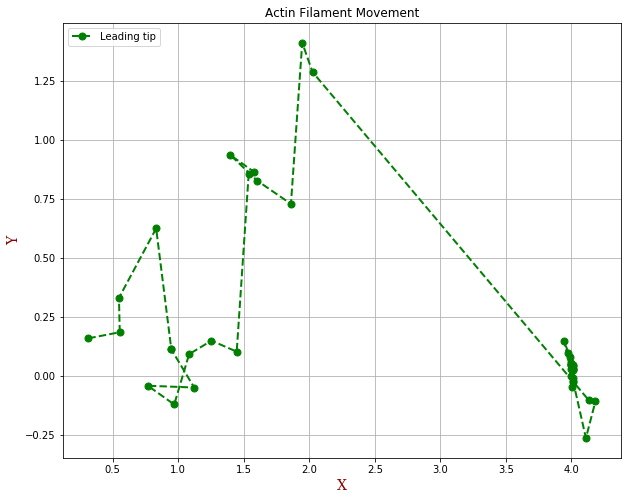

In [80]:
index_diff03 = np.diff(df03.index)
Dx = np.diff(df03['x']); Dy = np.diff(df03['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff03*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df03['x'],df03['y'], label='Leading tip', color='green', marker='o', \
         linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print(colored('Ave_vel:', 'yellow', attrs=['reverse', 'blink']), \
      colored(Av_vel, 'yellow', attrs=['reverse', 'blink']))
print(colored('VSD:', 'yellow', attrs=['reverse', 'blink']), \
      colored(vSD, 'yellow', attrs=['reverse', 'blink']))

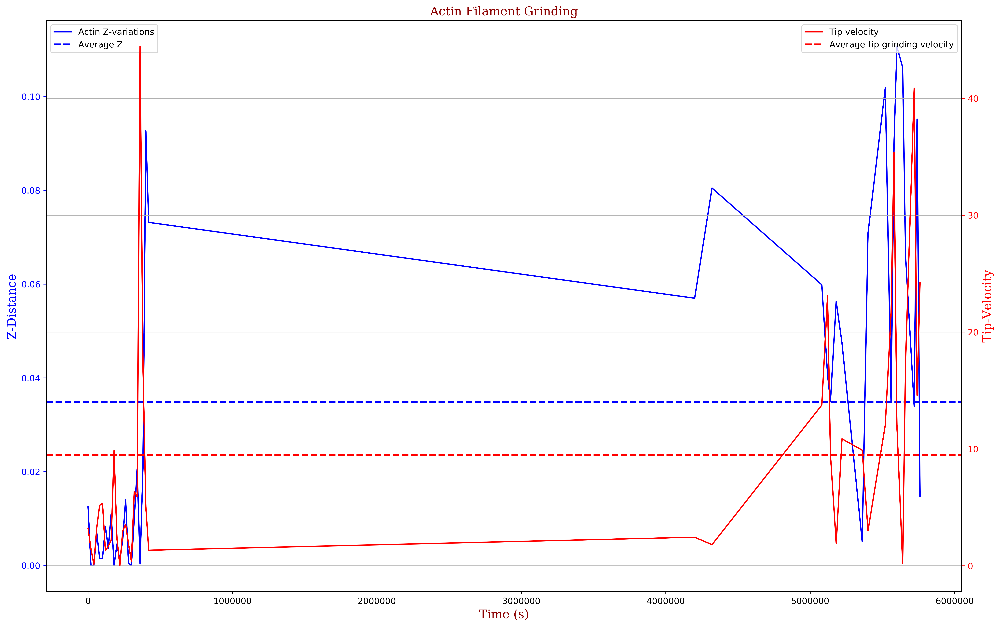

In [81]:
df03_ = df03.drop(df03.index[40]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df03_['time'],df03_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df03_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df03_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

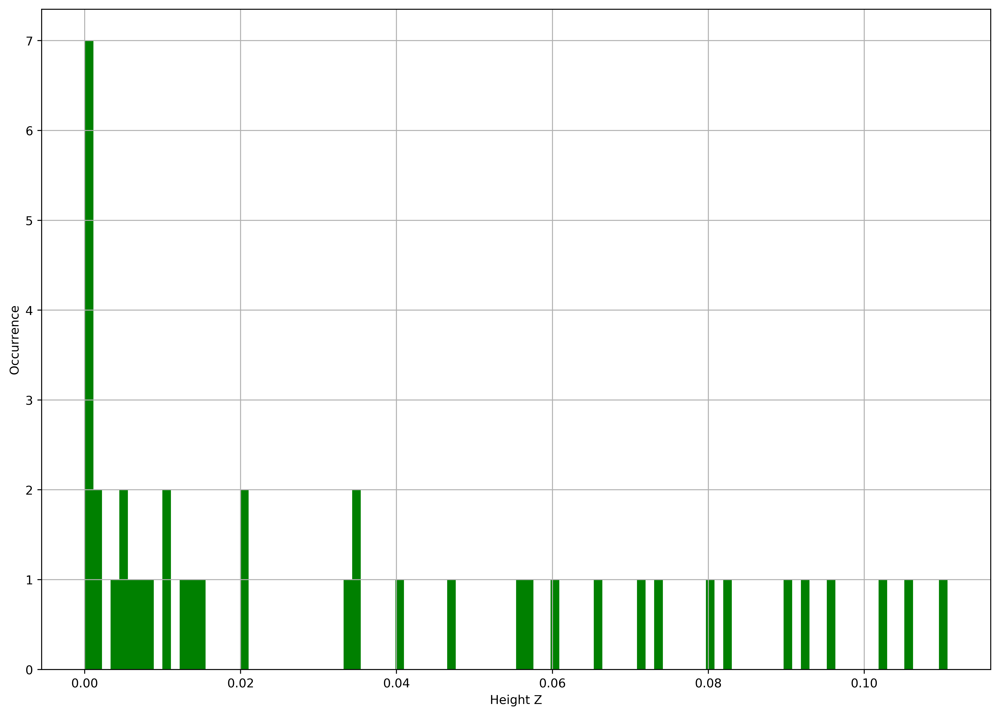

In [82]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df03['z'].hist(bins=100, ax=ax, color='green')

&#9676; 
`Leading tip grinding analysis for R0.35B13ATP2000MD3000:`

Ave_vel: 13.448639892409409
VSD: 11.546783285033328


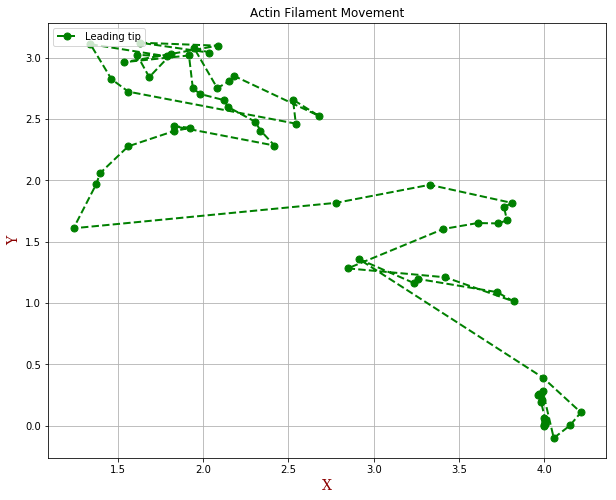

In [83]:
index_diff035 = np.diff(df035.index)
Dx = np.diff(df035['x']); Dy = np.diff(df035['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff035*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df035['x'],df035['y'], label='Leading tip', color='green', marker='o', \
         linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print(colored('Ave_vel:', 'yellow', attrs=['reverse', 'blink']), \
      colored(Av_vel, 'yellow', attrs=['reverse', 'blink']))
print(colored('VSD:', 'yellow', attrs=['reverse', 'blink']), \
      colored(vSD, 'yellow', attrs=['reverse', 'blink']))

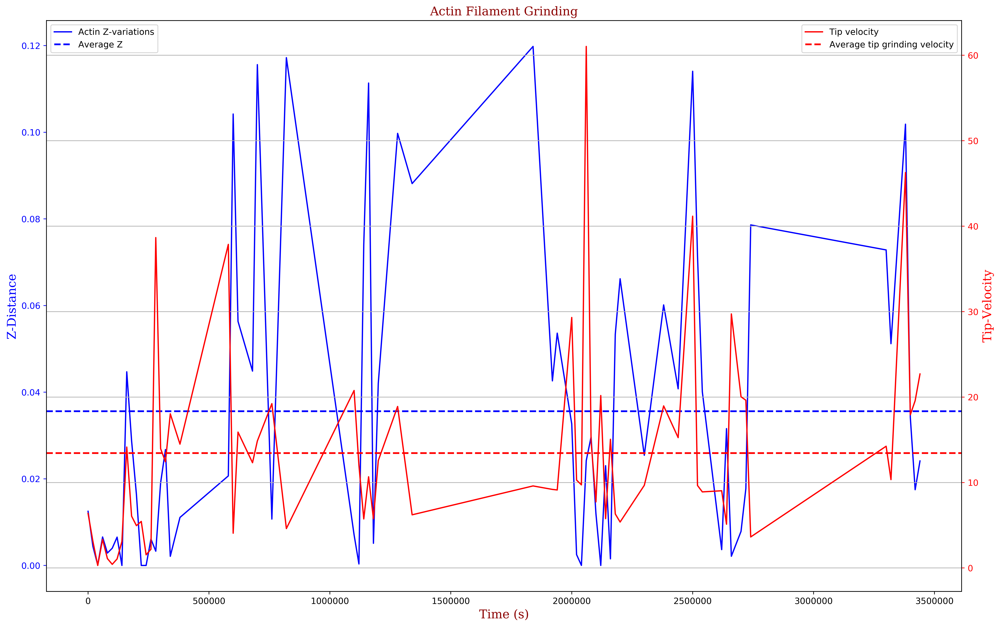

In [84]:
df035_ = df035.drop(df035.index[66]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df035_['time'],df035_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df035_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df035_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

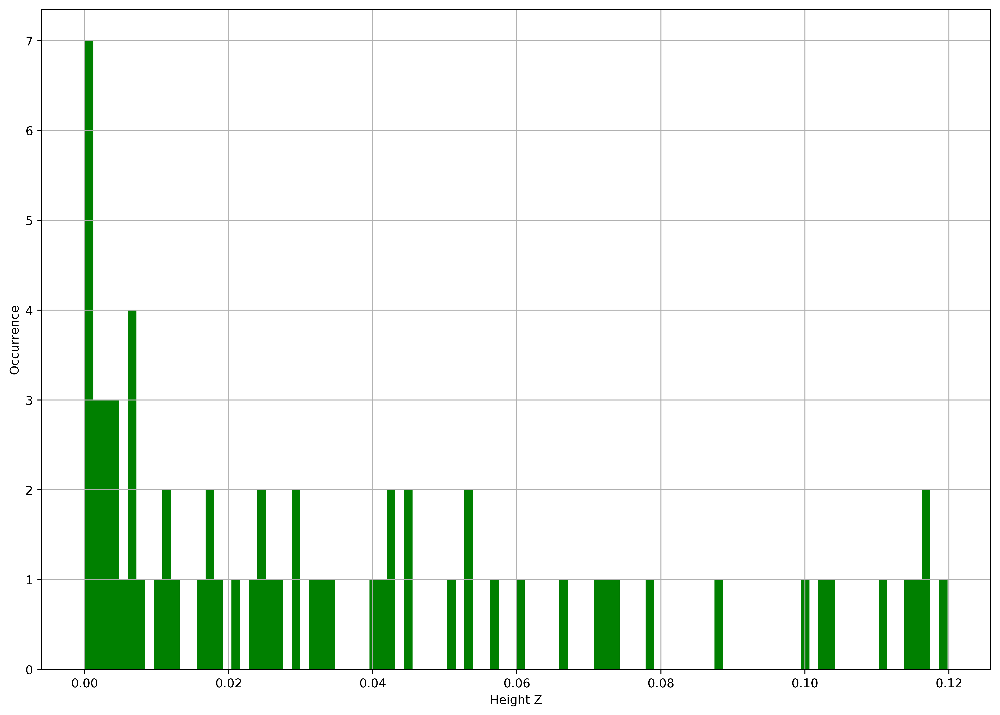

In [85]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df035['z'].hist(bins=100, ax=ax, color='green')

&#9676; `
Leading tip grinding analysis for R0.40B13ATP2000MD3000:`

Ave_vel: 12.409646552649724
VSD: 11.093747956924846


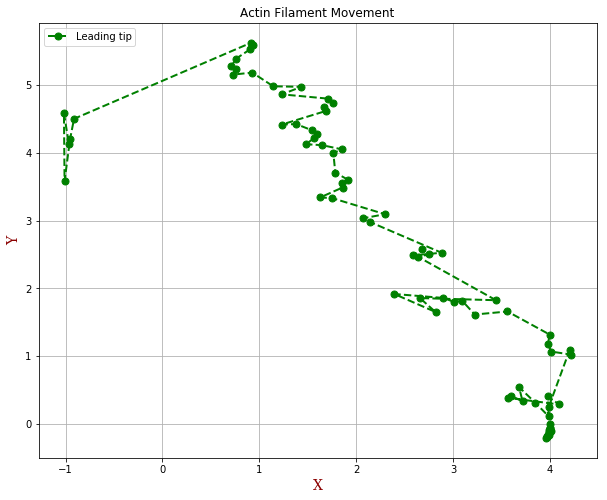

In [86]:
index_diff04 = np.diff(df04.index)
Dx = np.diff(df04['x']); Dy = np.diff(df04['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff04*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df04['x'],df04['y'], label='Leading tip', color='green', marker='o', \
         linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print(colored('Ave_vel:', 'yellow', attrs=['reverse', 'blink']), \
      colored(Av_vel, 'yellow', attrs=['reverse', 'blink']))
print(colored('VSD:', 'yellow', attrs=['reverse', 'blink']), \
      colored(vSD, 'yellow', attrs=['reverse', 'blink']))

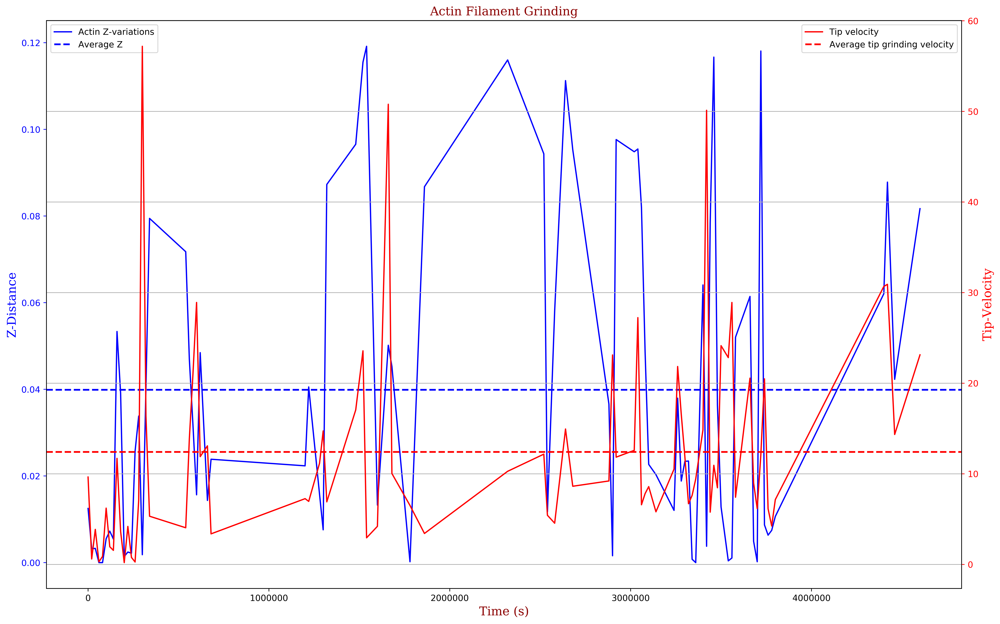

In [87]:
df04_ = df04.drop(df04.index[81]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df04_['time'],df04_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df04_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df04_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

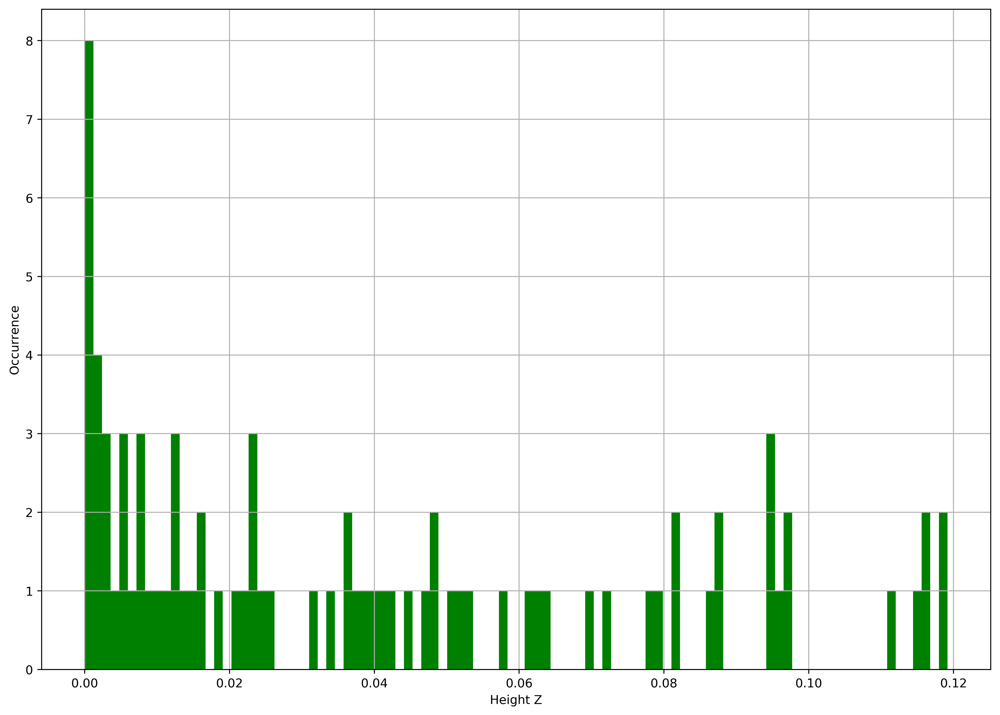

In [88]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df04['z'].hist(bins=100, ax=ax, color='green')

&#9676; 
`Leading tip grinding analysis for R0.45B13ATP2000MD3000:`

Ave_vel: 10.015138577365649
VSD: 8.229601963609156


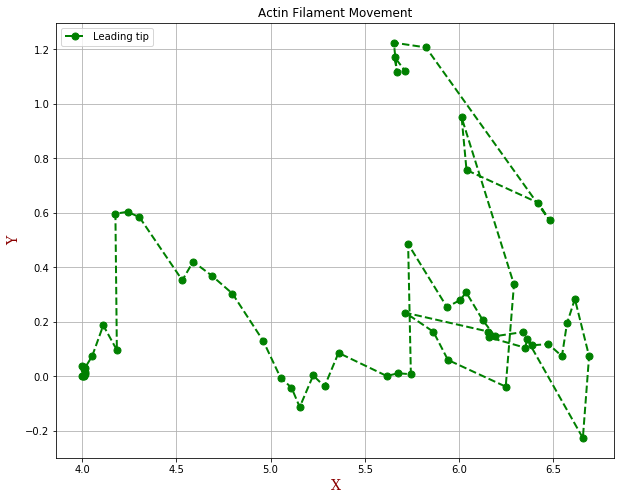

In [26]:
index_diff045 = np.diff(df045.index)
Dx = np.diff(df045['x']); Dy = np.diff(df045['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff045*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df045['x'],df045['y'], label='Leading tip', color='green', marker='o', \
         linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print(colored('Ave_vel:', 'yellow', attrs=['reverse', 'blink']), \
      colored(Av_vel, 'yellow', attrs=['reverse', 'blink']))
print(colored('VSD:', 'yellow', attrs=['reverse', 'blink']), \
      colored(vSD, 'yellow', attrs=['reverse', 'blink']))

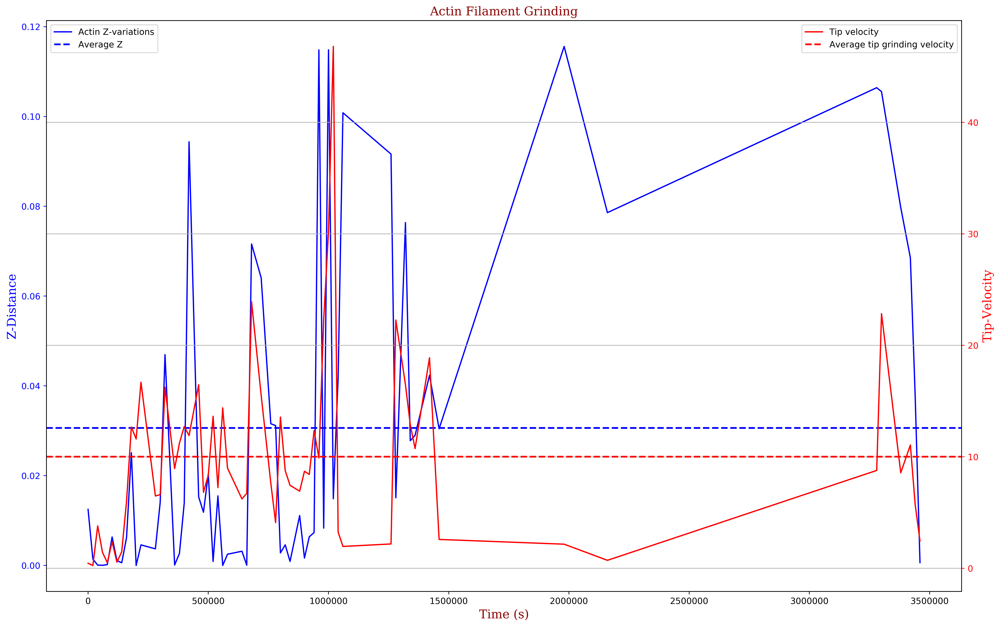

In [27]:
df045_ = df045.drop(df045.index[60]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df045_['time'],df045_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df045_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df045_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

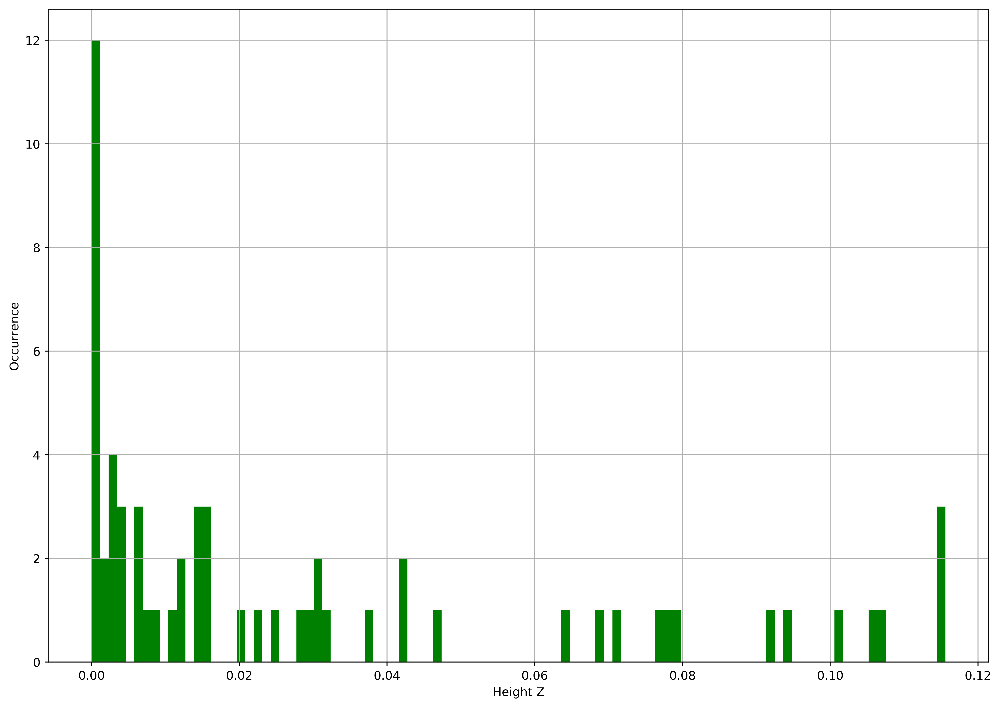

In [28]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df045['z'].hist(bins=100, ax=ax, color='green')

&#9676; 
`Leading tip grinding analysis for R0.50B13ATP2000MD3000:`

Ave_vel: 10.53953829421381
VSD: 8.713125283876595


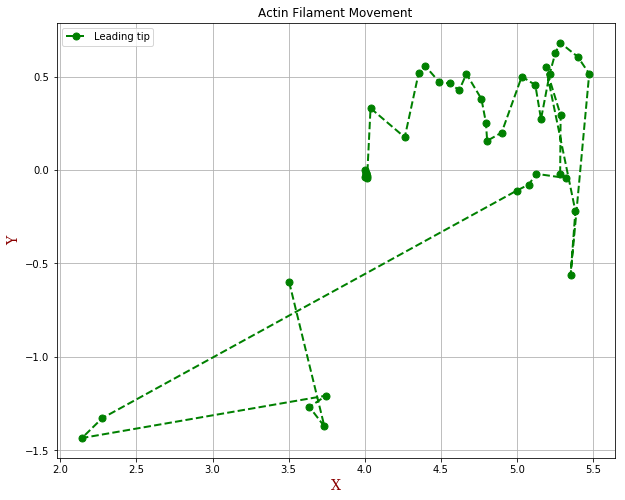

In [29]:
index_diff05 = np.diff(df05.index)
Dx = np.diff(df05['x']); Dy = np.diff(df05['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff05*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df05['x'],df05['y'], label='Leading tip', color='green', marker='o', \
         linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print(colored('Ave_vel:', 'yellow', attrs=['reverse', 'blink']), \
      colored(Av_vel, 'yellow', attrs=['reverse', 'blink']))
print(colored('VSD:', 'yellow', attrs=['reverse', 'blink']), \
      colored(vSD, 'yellow', attrs=['reverse', 'blink']))

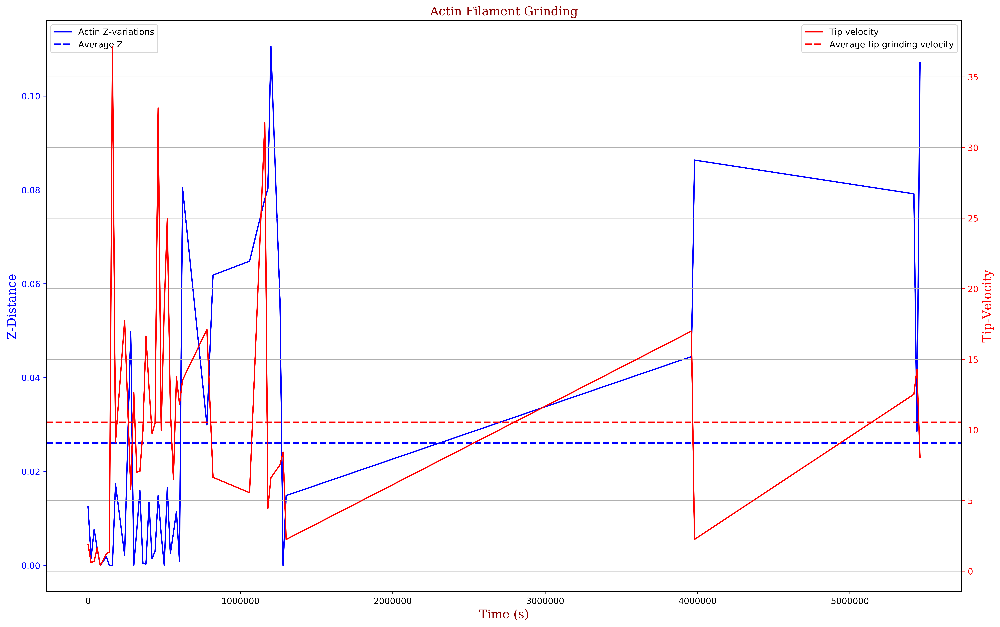

In [30]:
df05_ = df05.drop(df05.index[43]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df05_['time'],df05_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df05_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df05_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

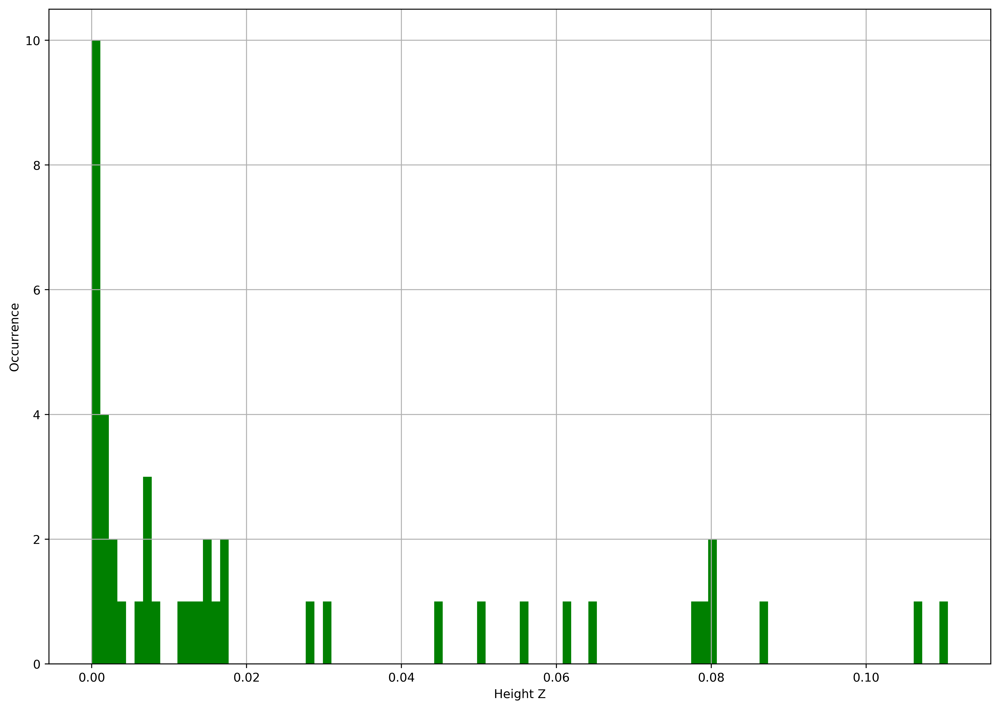

In [31]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df05['z'].hist(bins=100, ax=ax, color='green')

&#9676; 
`Leading tip grinding analysis for R0.55B13ATP2000MD3000:`

Ave_vel: 13.527845856280615
VSD: 8.541105565939676


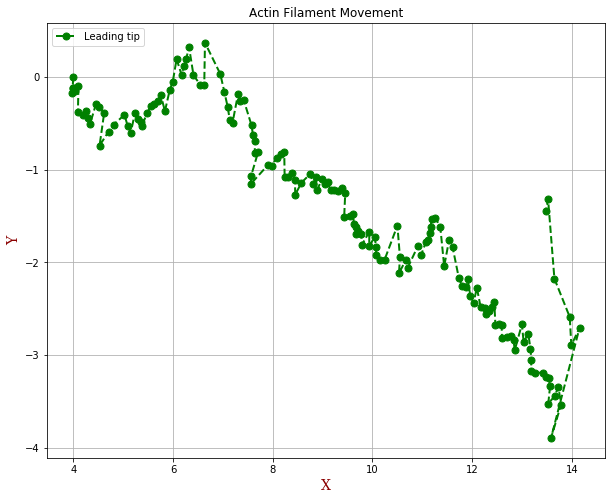

In [32]:
index_diff055 = np.diff(df055.index)
Dx = np.diff(df055['x']); Dy = np.diff(df055['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff055*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df055['x'],df055['y'], label='Leading tip', color='green', marker='o', \
         linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print(colored('Ave_vel:', 'yellow', attrs=['reverse', 'blink']), \
      colored(Av_vel, 'yellow', attrs=['reverse', 'blink']))
print(colored('VSD:', 'yellow', attrs=['reverse', 'blink']), \
      colored(vSD, 'yellow', attrs=['reverse', 'blink']))

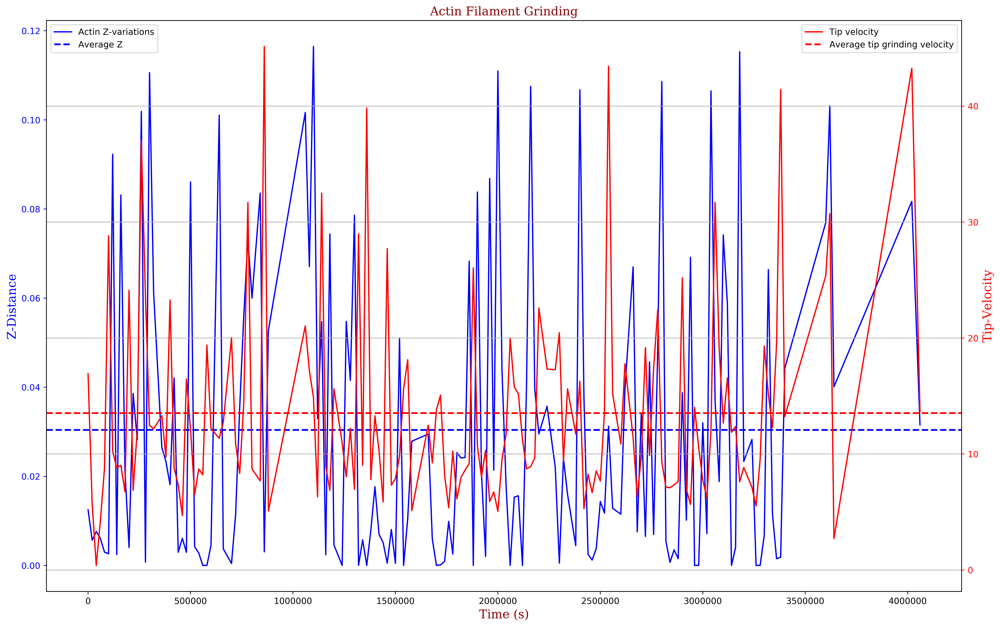

In [33]:
df055_ = df055.drop(df055.index[154]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df055_['time'],df055_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df055_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df055_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

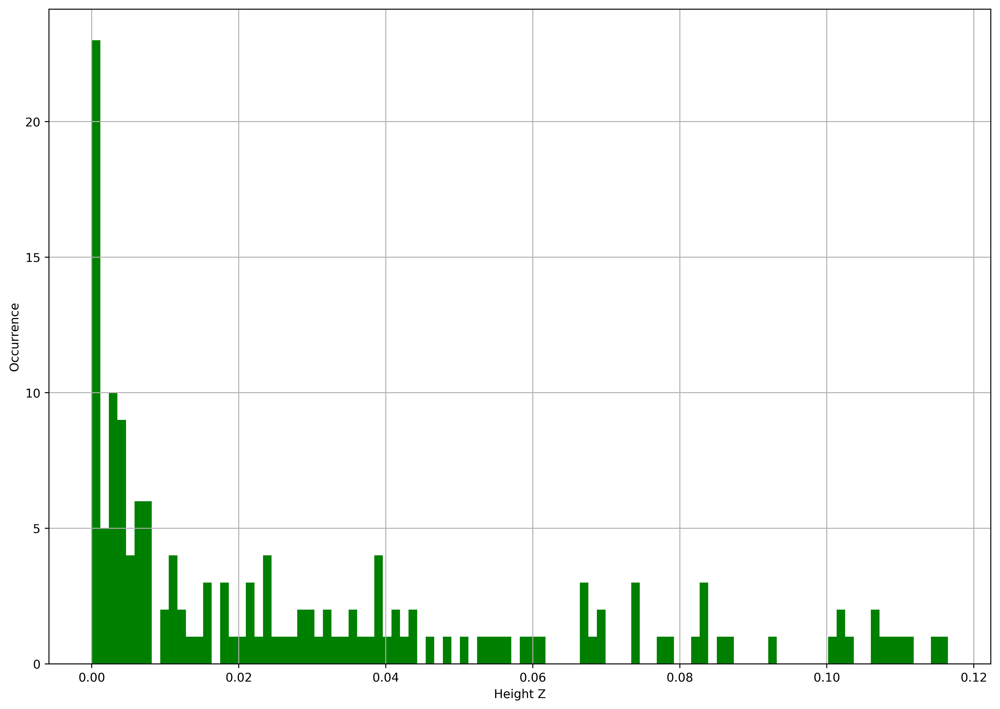

In [34]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df055['z'].hist(bins=100, ax=ax, color='green')

&#9676; 
`Leading tip grinding analysis for R0.60B13ATP2000MD3000:`

Ave_vel: 13.165139831936234
VSD: 8.141510154048126


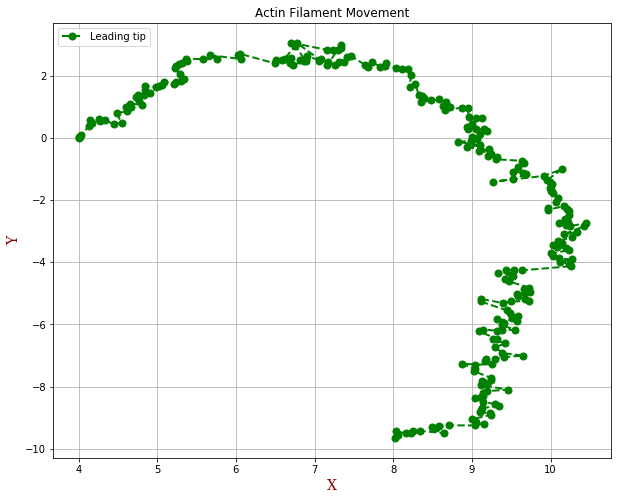

In [35]:
index_diff06 = np.diff(df06.index)
Dx = np.diff(df06['x']); Dy = np.diff(df06['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff06*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df06['x'],df06['y'], label='Leading tip', color='green', marker='o', \
         linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print(colored('Ave_vel:', 'yellow', attrs=['reverse', 'blink']), \
      colored(Av_vel, 'yellow', attrs=['reverse', 'blink']))
print(colored('VSD:', 'yellow', attrs=['reverse', 'blink']), \
      colored(vSD, 'yellow', attrs=['reverse', 'blink']))

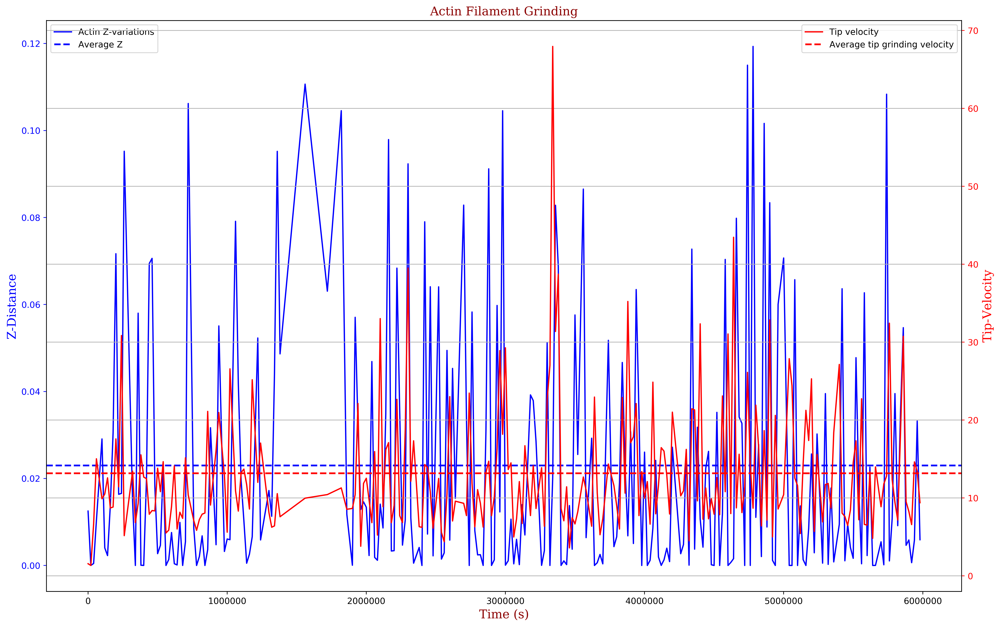

In [36]:
df06_ = df06.drop(df06.index[253]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df06_['time'],df06_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df06_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df06_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

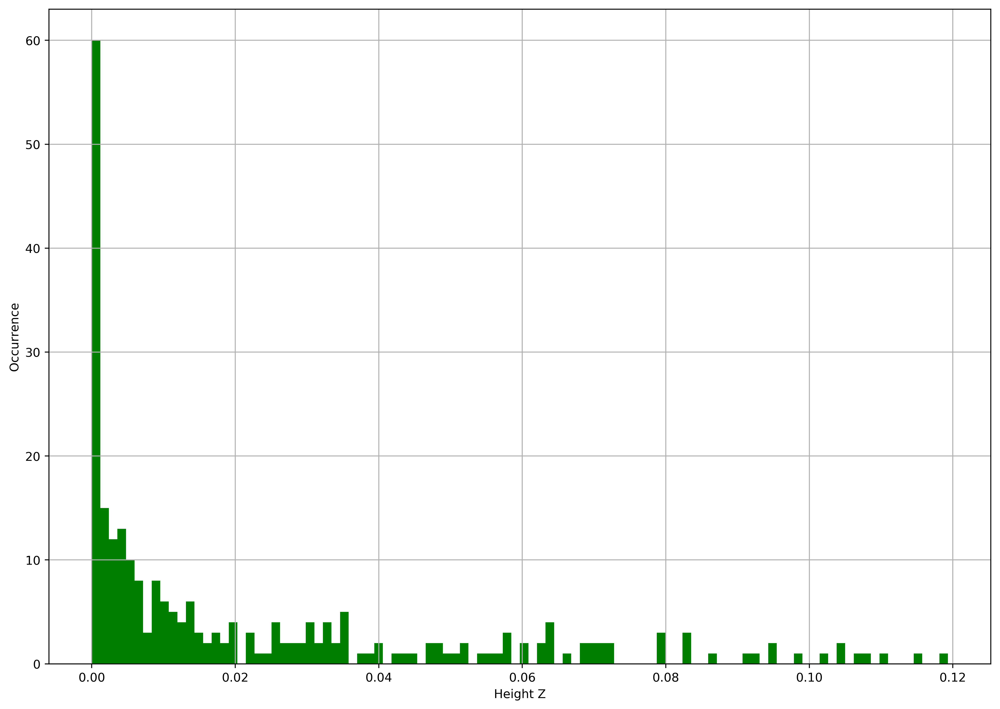

In [37]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df06['z'].hist(bins=100, ax=ax, color='green')

&#9676; 
`Leading tip grinding analysis for R0.65B13ATP2000MD3000:`

Ave_vel: 12.04318236805964
VSD: 7.306770348141472


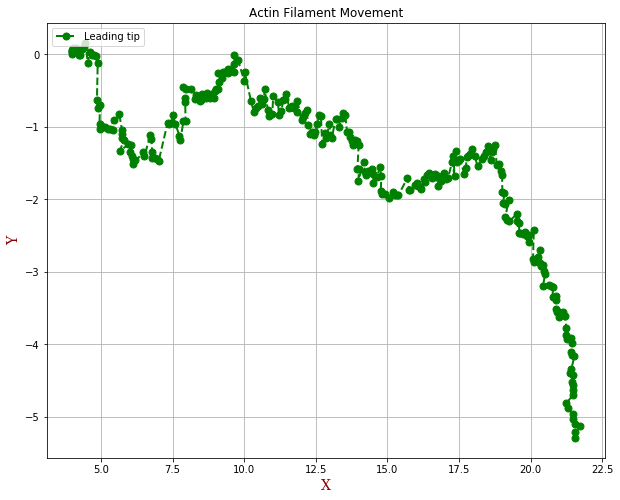

In [38]:
index_diff065 = np.diff(df065.index)
Dx = np.diff(df065['x']); Dy = np.diff(df065['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff065*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df065['x'],df065['y'], label='Leading tip', color='green', marker='o', \
         linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print(colored('Ave_vel:', 'yellow', attrs=['reverse', 'blink']), \
      colored(Av_vel, 'yellow', attrs=['reverse', 'blink']))
print(colored('VSD:', 'yellow', attrs=['reverse', 'blink']), \
      colored(vSD, 'yellow', attrs=['reverse', 'blink']))

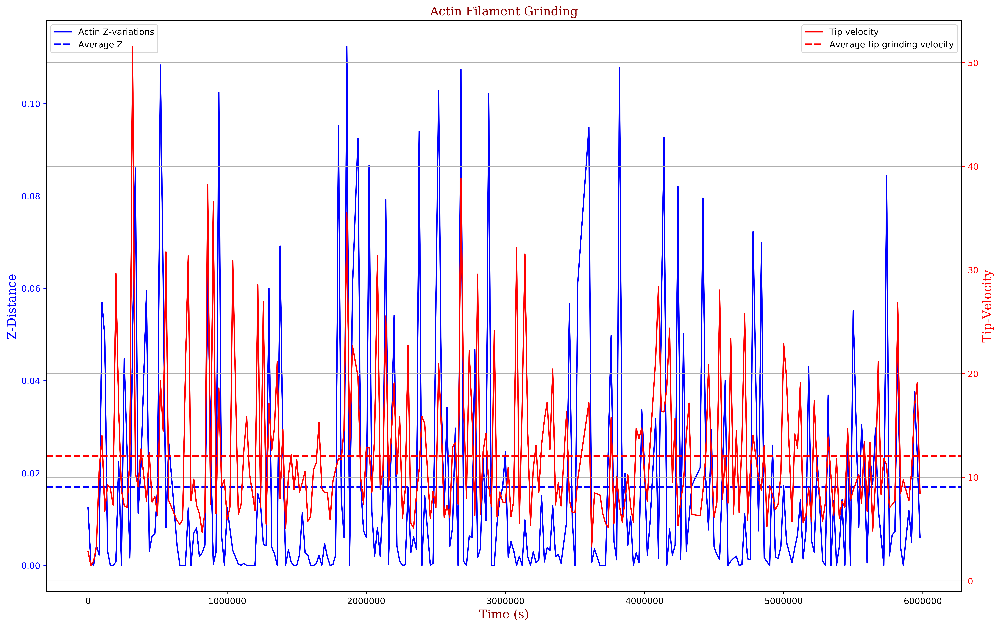

In [39]:
df065_ = df065.drop(df065.index[279]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df065_['time'],df065_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df065_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df065_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

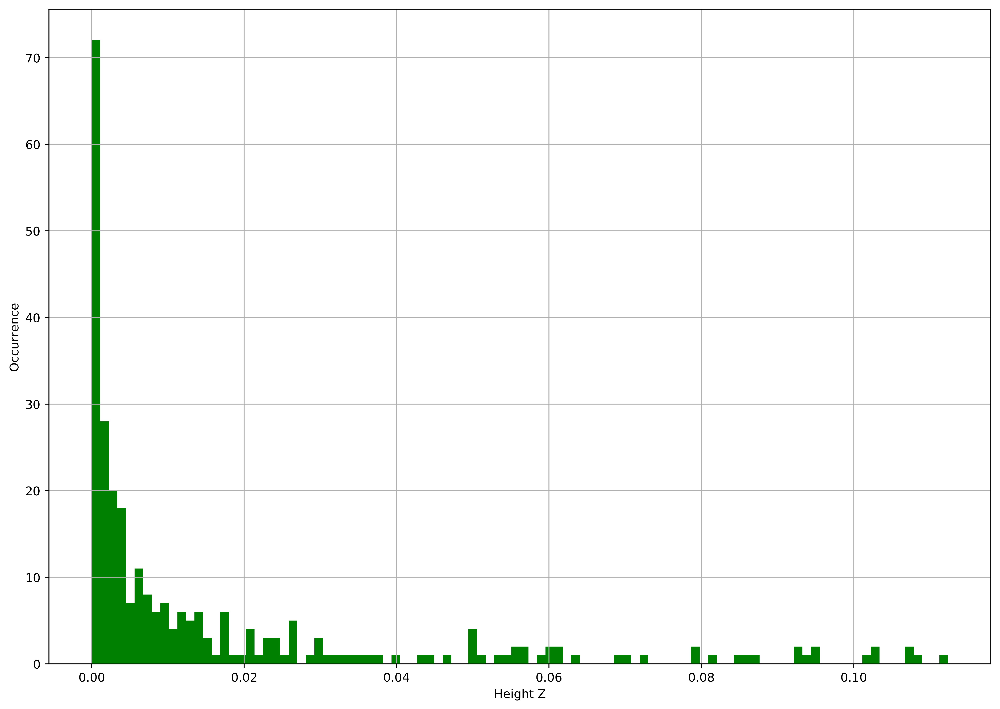

In [40]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df065['z'].hist(bins=100, ax=ax, color='green')

&#9676; 
`Leading tip grinding analysis for R0.70B13ATP2000MD3000:`

Ave_vel: 12.33191415418844
VSD: 7.505000160488821


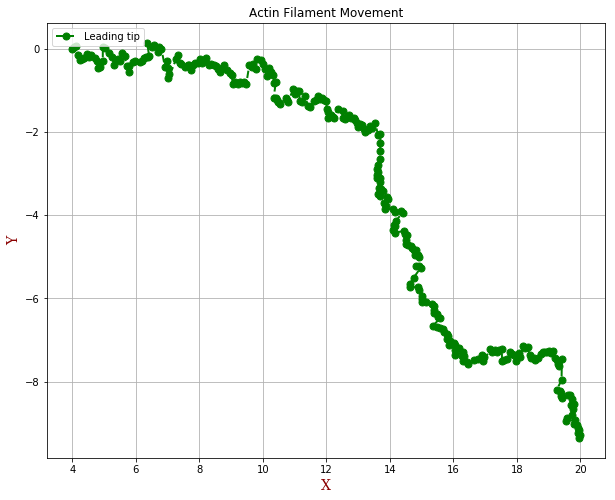

In [41]:
index_diff07 = np.diff(df07.index)
Dx = np.diff(df07['x']); Dy = np.diff(df07['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff07*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df07['x'],df07['y'], label='Leading tip', color='green', marker='o', \
         linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print(colored('Ave_vel:', 'yellow', attrs=['reverse', 'blink']), \
      colored(Av_vel, 'yellow', attrs=['reverse', 'blink']))
print(colored('VSD:', 'yellow', attrs=['reverse', 'blink']), \
      colored(vSD, 'yellow', attrs=['reverse', 'blink']))

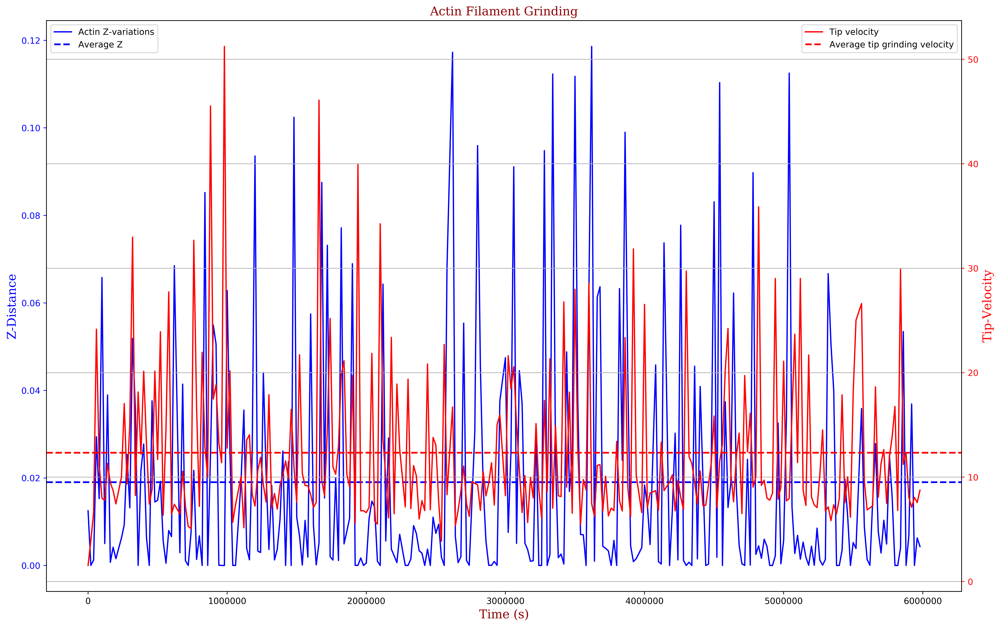

In [42]:
df07_ = df07.drop(df07.index[290]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df07_['time'],df07_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df07_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df07_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

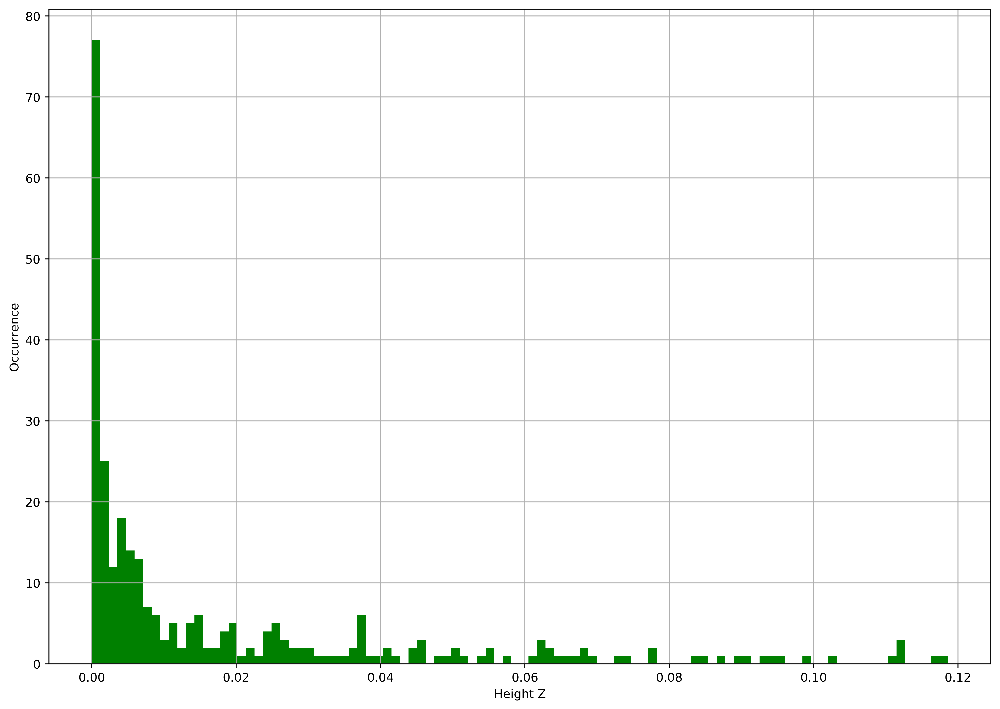

In [43]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df07['z'].hist(bins=100, ax=ax, color='green')

&#9676; 
`Leading tip grinding analysis for R0.75B13ATP2000MD3000:`

Ave_vel: 11.723131066566607
VSD: 7.1164650664182965


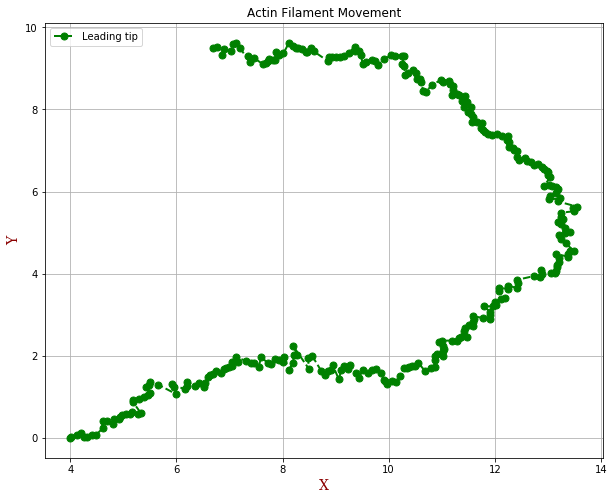

In [44]:
index_diff075 = np.diff(df075.index)
Dx = np.diff(df075['x']); Dy = np.diff(df075['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff075*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df075['x'],df075['y'], label='Leading tip', color='green', marker='o', \
         linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print(colored('Ave_vel:', 'yellow', attrs=['reverse', 'blink']), \
      colored(Av_vel, 'yellow', attrs=['reverse', 'blink']))
print(colored('VSD:', 'yellow', attrs=['reverse', 'blink']), \
      colored(vSD, 'yellow', attrs=['reverse', 'blink']))

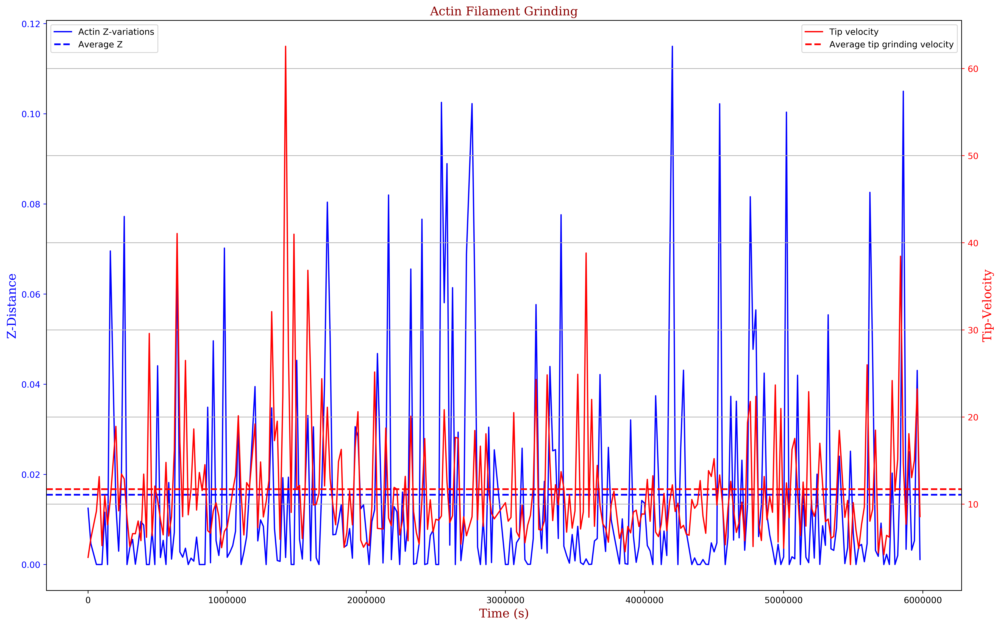

In [45]:
df075_ = df075.drop(df075.index[290]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df075_['time'],df075_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df075_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df075_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

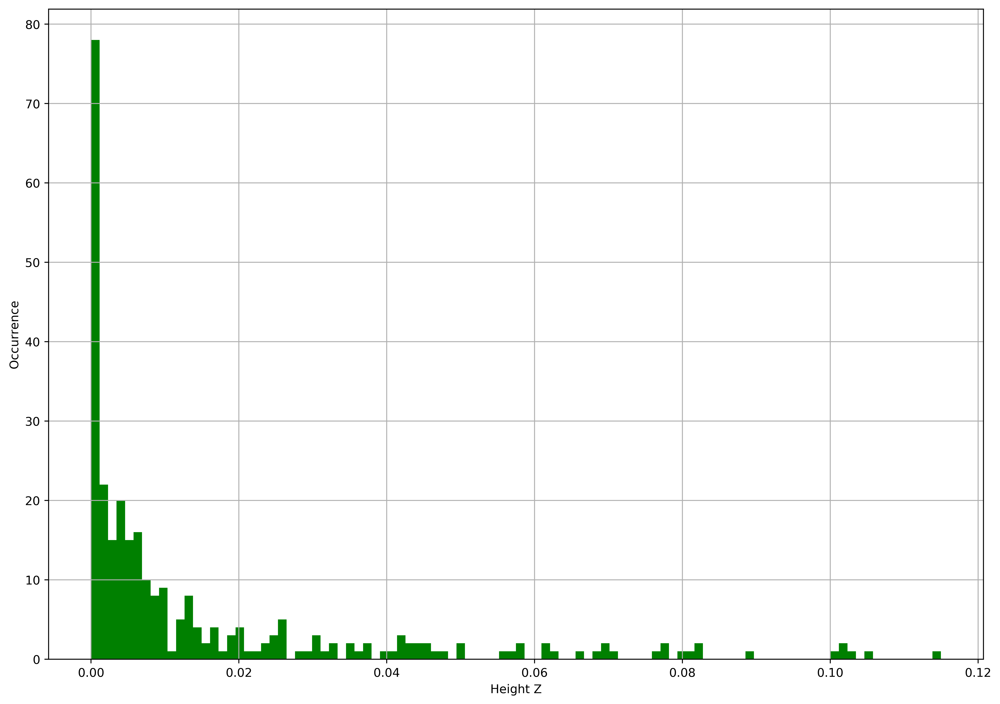

In [46]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df075['z'].hist(bins=100, ax=ax, color='green')

&#9676; 
`Leading tip grinding analysis for R0.80B13ATP2000MD3000:`

Ave_vel: 11.691965618426297
VSD: 7.248935548162617


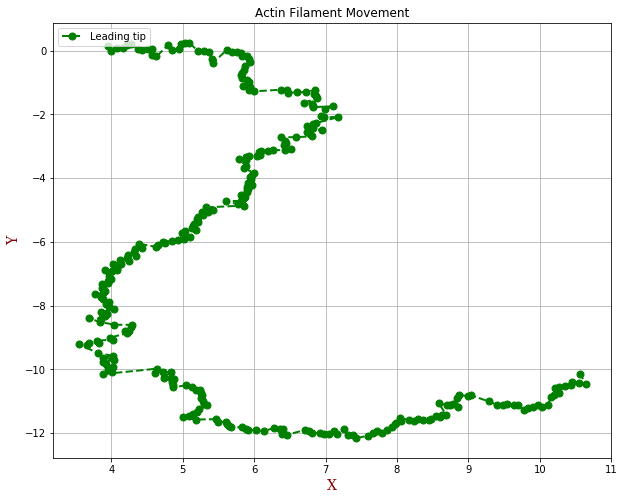

In [47]:
index_diff08 = np.diff(df08.index)
Dx = np.diff(df08['x']); Dy = np.diff(df08['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff08*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df08['x'],df08['y'], label='Leading tip', color='green', marker='o', \
         linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print(colored('Ave_vel:', 'yellow', attrs=['reverse', 'blink']), \
      colored(Av_vel, 'yellow', attrs=['reverse', 'blink']))
print(colored('VSD:', 'yellow', attrs=['reverse', 'blink']), \
      colored(vSD, 'yellow', attrs=['reverse', 'blink']))

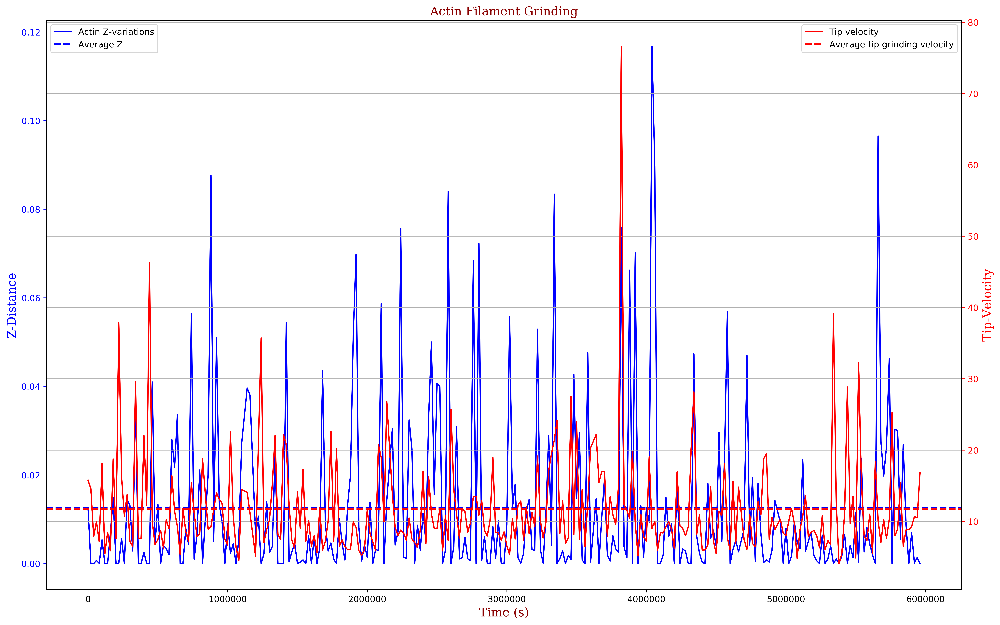

In [48]:
df08_ = df08.drop(df08.index[292]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df08_['time'],df08_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df08_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df08_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

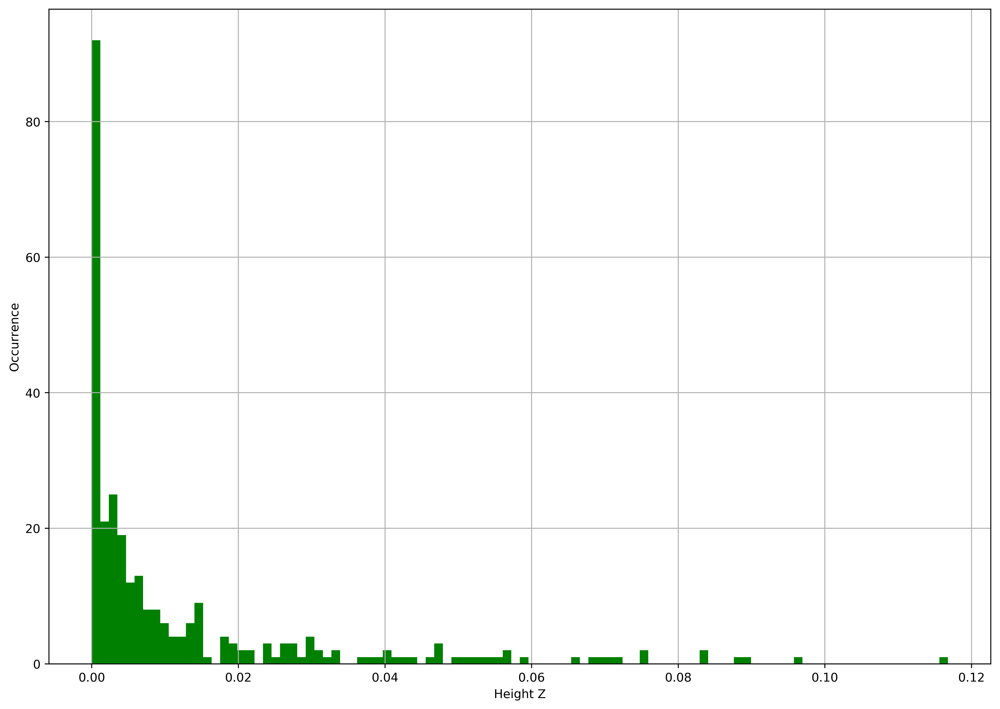

In [49]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df08['z'].hist(bins=100, ax=ax, color='green')

&#9676; 
`Leading tip grinding analysis for R0.85B13ATP2000MD3000:`

Ave_vel: 10.876282259663984
VSD: 5.304207571905855


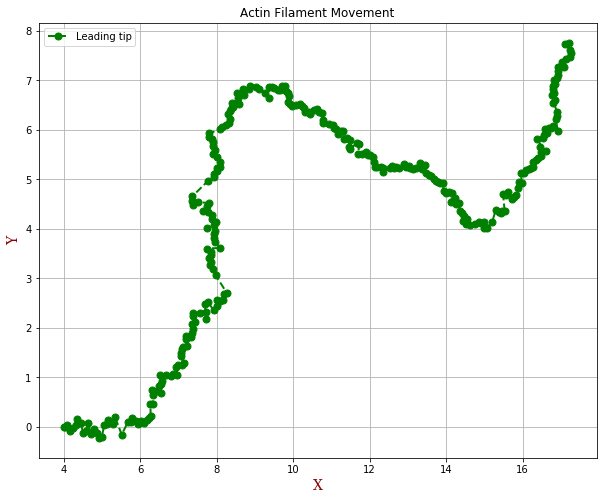

In [50]:
index_diff085 = np.diff(df085.index)
Dx = np.diff(df085['x']); Dy = np.diff(df085['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff085*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df085['x'],df085['y'], label='Leading tip', color='green', marker='o', \
         linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print(colored('Ave_vel:', 'yellow', attrs=['reverse', 'blink']), \
      colored(Av_vel, 'yellow', attrs=['reverse', 'blink']))
print(colored('VSD:', 'yellow', attrs=['reverse', 'blink']), \
      colored(vSD, 'yellow', attrs=['reverse', 'blink']))

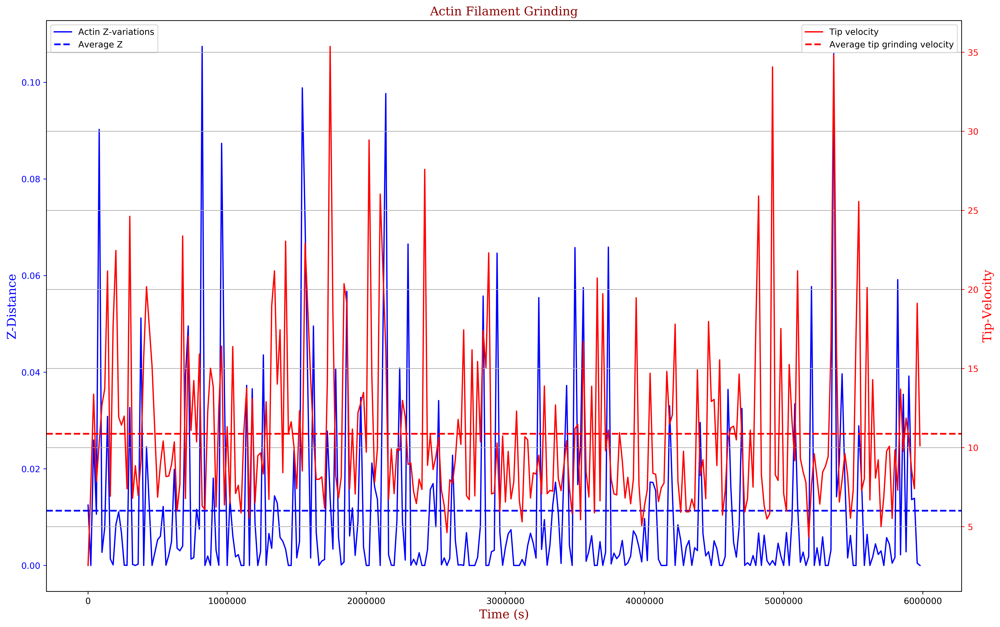

In [51]:
df085_ = df085.drop(df085.index[295]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df085_['time'],df085_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df085_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df085_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

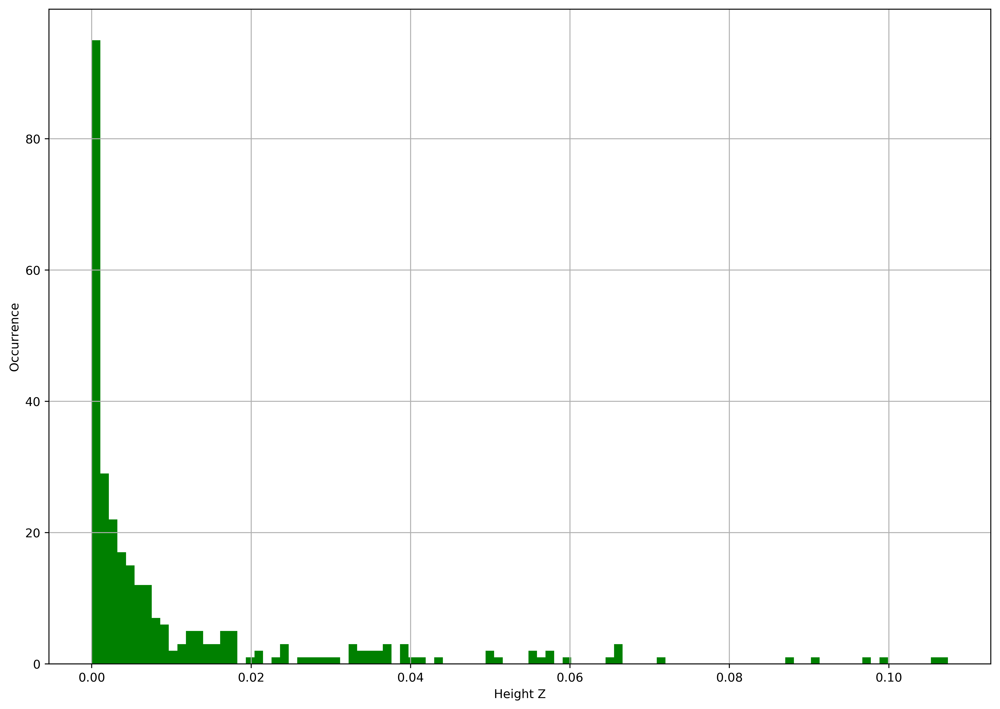

In [52]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df085['z'].hist(bins=100, ax=ax, color='green')

&#9676; 
`Leading tip grinding analysis for R0.90B13ATP2000MD3000:`

Ave_vel: 11.316034120970297
VSD: 6.288090934188312


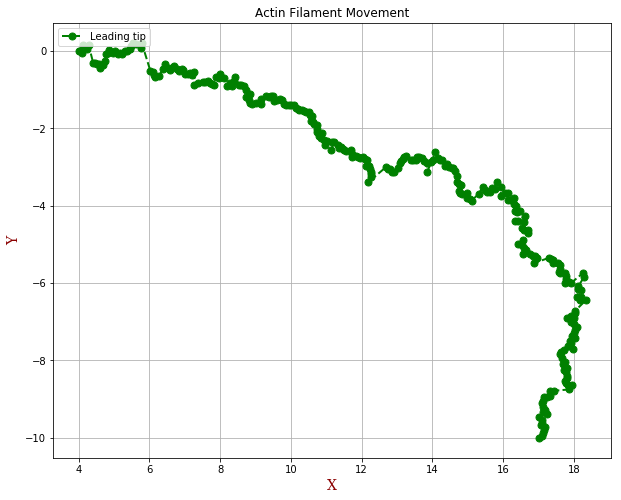

In [53]:
index_diff09 = np.diff(df09.index)
Dx = np.diff(df09['x']); Dy = np.diff(df09['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff09*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df09['x'],df09['y'], label='Leading tip', color='green', marker='o', \
         linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print(colored('Ave_vel:', 'yellow', attrs=['reverse', 'blink']), \
      colored(Av_vel, 'yellow', attrs=['reverse', 'blink']))
print(colored('VSD:', 'yellow', attrs=['reverse', 'blink']), \
      colored(vSD, 'yellow', attrs=['reverse', 'blink']))

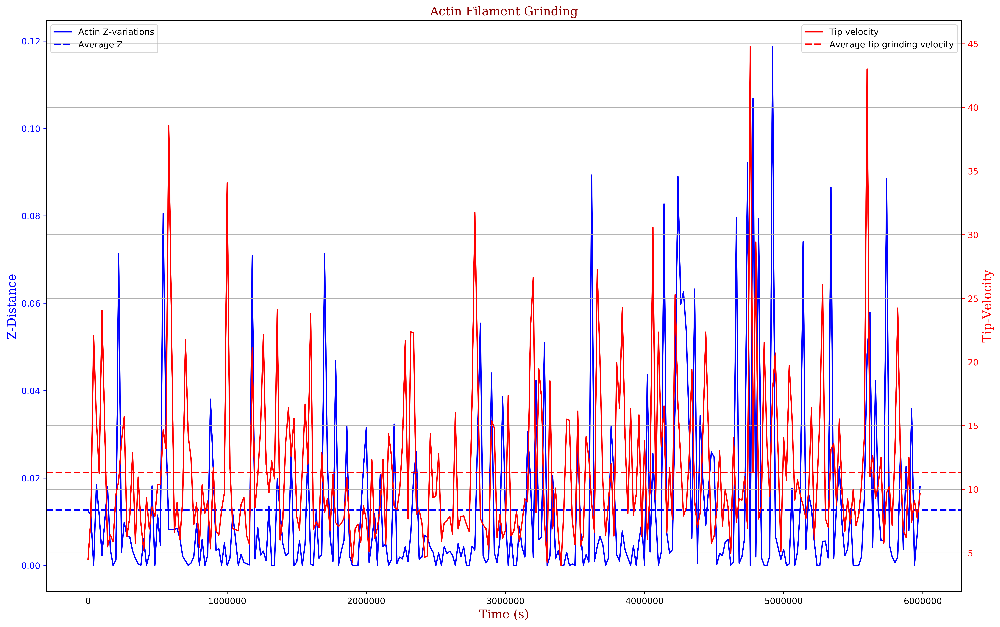

In [54]:
df09_ = df09.drop(df09.index[294]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df09_['time'],df09_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df09_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df09_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

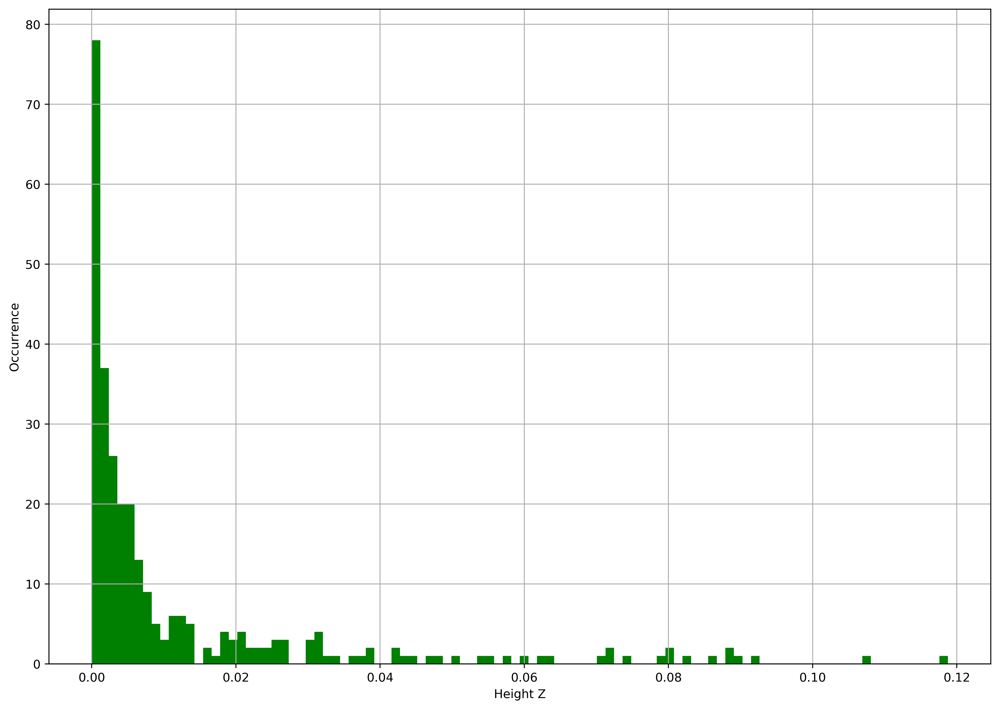

In [55]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df09['z'].hist(bins=100, ax=ax, color='green')

&#9676; 
`Leading tip grinding analysis for R0.95B13ATP2000MD3000:`

Ave_vel: 10.762110292673217
VSD: 6.165490412821767


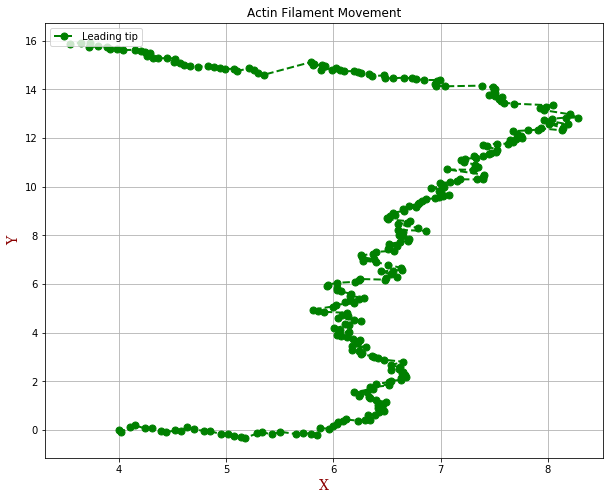

In [56]:
index_diff095 = np.diff(df095.index)
Dx = np.diff(df095['x']); Dy = np.diff(df095['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff095*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df095['x'],df095['y'], label='Leading tip', color='green', marker='o', \
         linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print(colored('Ave_vel:', 'yellow', attrs=['reverse', 'blink']), \
      colored(Av_vel, 'yellow', attrs=['reverse', 'blink']))
print(colored('VSD:', 'yellow', attrs=['reverse', 'blink']), \
      colored(vSD, 'yellow', attrs=['reverse', 'blink']))

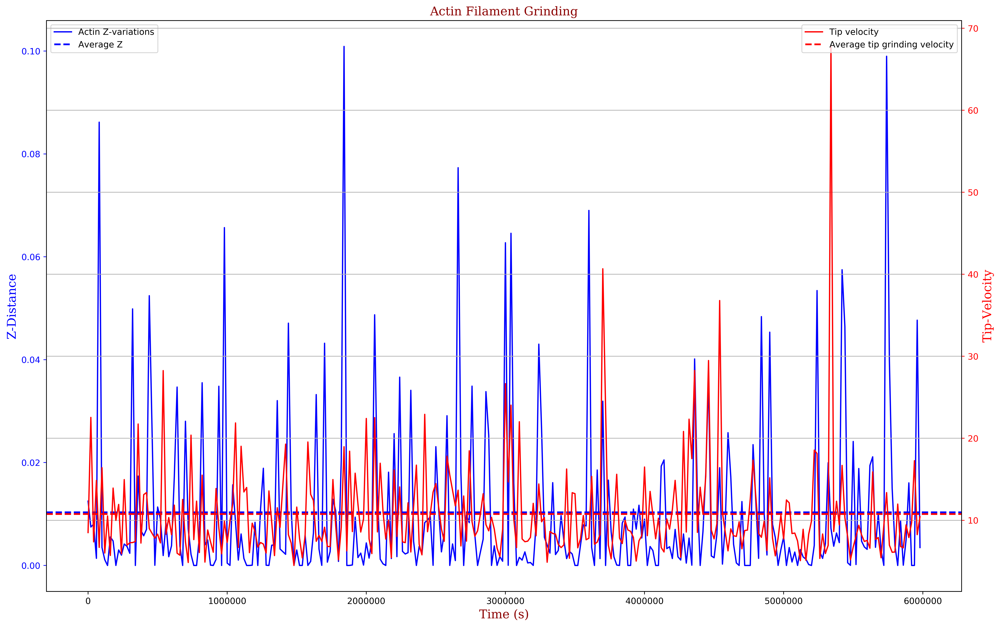

In [57]:
df095_ = df095.drop(df095.index[297]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df095_['time'],df095_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df095_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df095_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

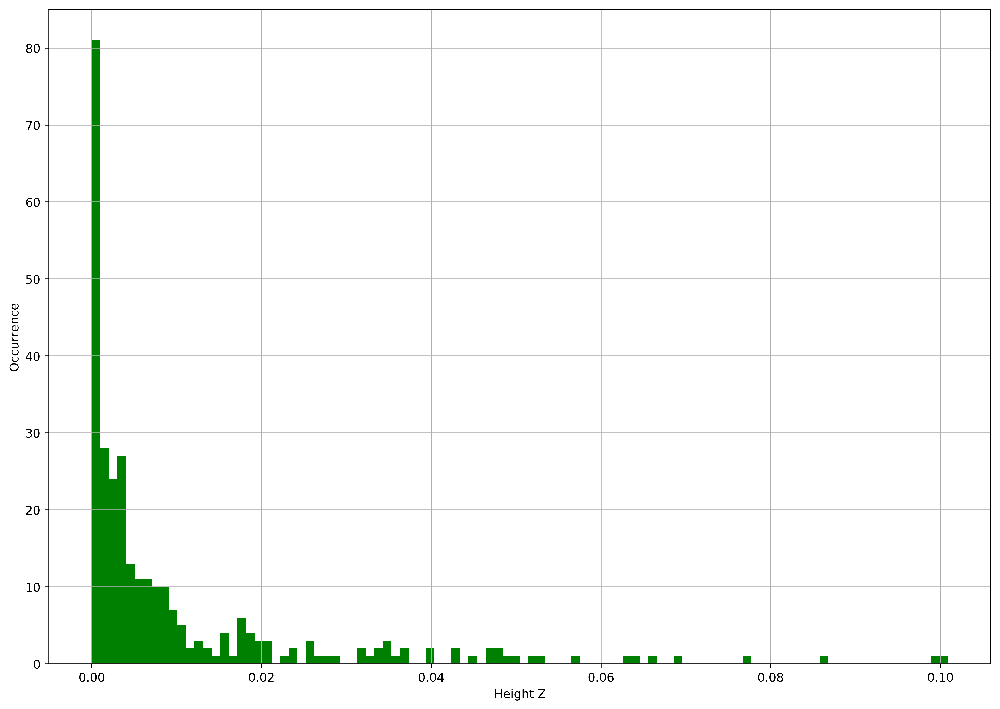

In [58]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df095['z'].hist(bins=100, ax=ax, color='green')

&#9676; 
`Leading tip grinding analysis for R1.00B13ATP2000MD3000:`

Ave_vel: 10.834874773271228
VSD: 5.646034608042509


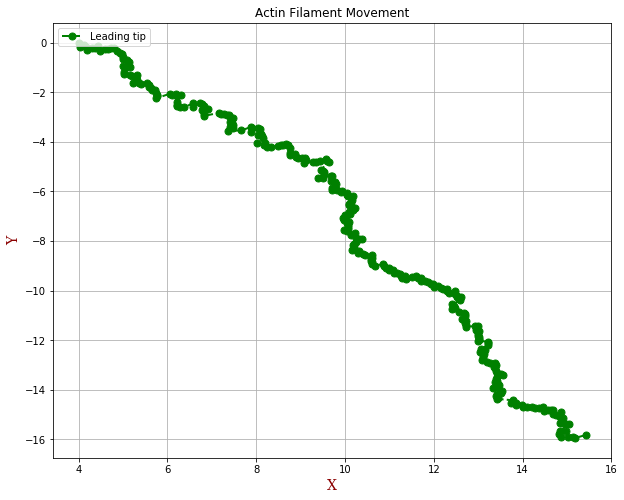

In [59]:
index_diff10 = np.diff(df10.index)
Dx = np.diff(df10['x']); Dy = np.diff(df10['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff10*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df10['x'],df10['y'], label='Leading tip', color='green', marker='o', \
         linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print(colored('Ave_vel:', 'yellow', attrs=['reverse', 'blink']), \
      colored(Av_vel, 'yellow', attrs=['reverse', 'blink']))
print(colored('VSD:', 'yellow', attrs=['reverse', 'blink']), \
      colored(vSD, 'yellow', attrs=['reverse', 'blink']))

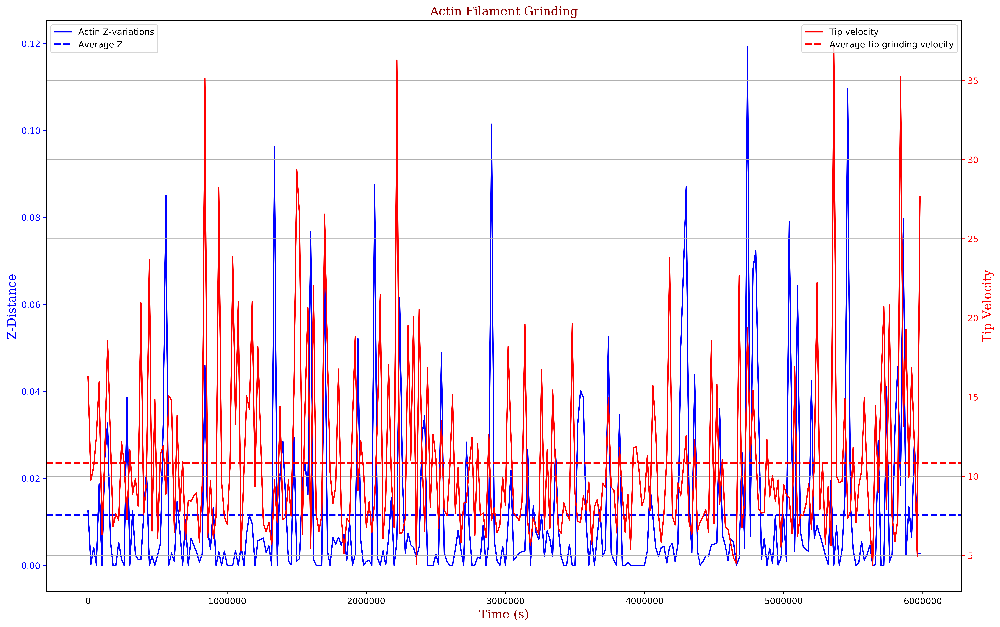

In [60]:
df10_ = df10.drop(df10.index[297]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df10_['time'],df10_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df10_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df10_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

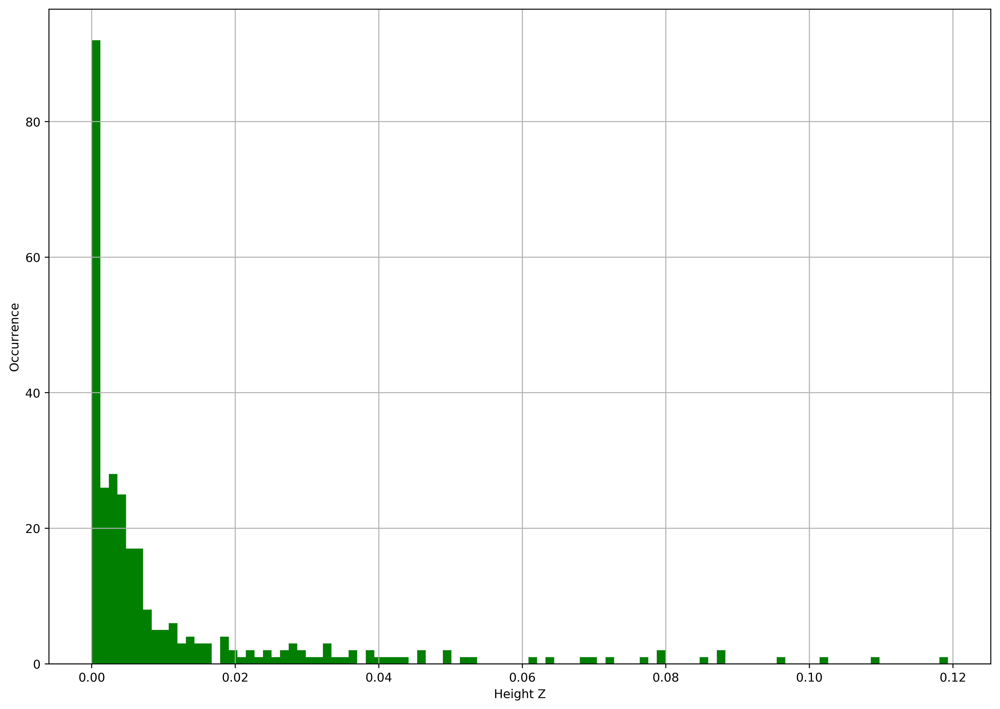

In [61]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df10['z'].hist(bins=100, ax=ax, color='green')

### Leading tip mean grinding velocity as specie ratio (R) varies, for B13ATP2000MD3000

&#9676; 
`Grinding velocity changes:`

In [62]:
column_names = ['r','b','atp','md','v','vsd']
gdta = pd.read_csv('grinding_vel.csv', names=column_names); gdta

,r,b,atp,md,v,vsd
0,0.10,13,2000,3000,0.926474,0.626523
1,0.15,13,2000,3000,3.406925,2.796185
2,0.20,13,2000,3000,3.216800,3.076401
3,0.25,13,2000,3000,1.088440,0.840480
4,0.30,13,2000,3000,9.501907,11.116915
5,0.35,13,2000,3000,13.448640,11.546783
6,0.40,13,2000,3000,12.409647,11.093748
7,0.45,13,2000,3000,10.015139,8.229602
8,0.50,13,2000,3000,10.539538,8.713125
9,0.55,13,2000,3000,13.527846,8.541106


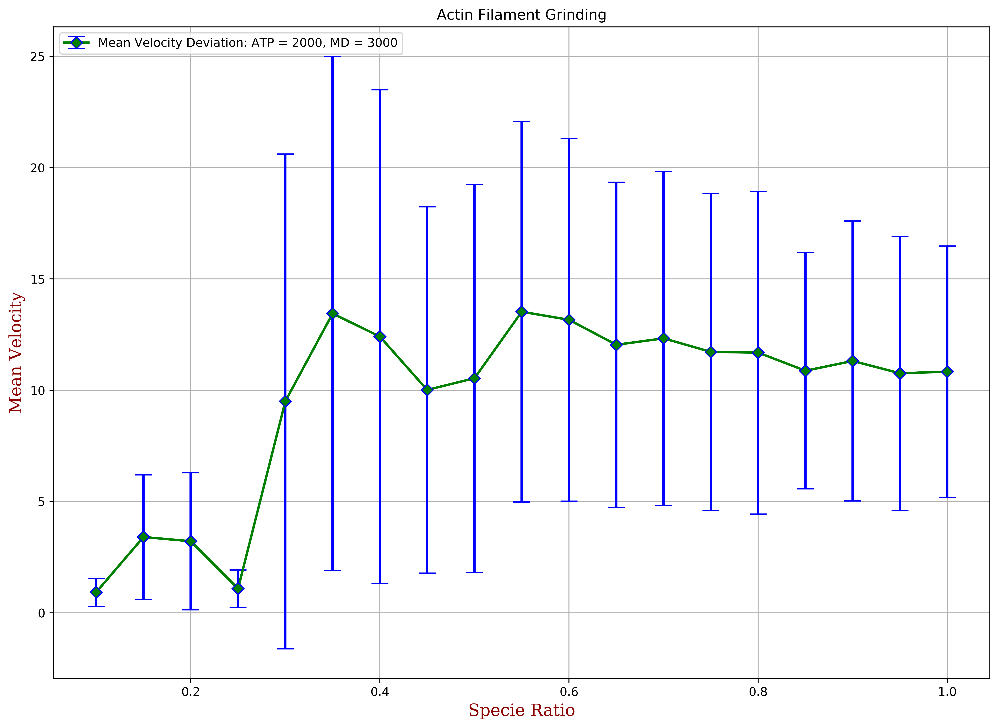

In [63]:
plt.figure(figsize=(14,10), dpi=500)
plt.errorbar(gdta['r'],gdta['v'],yerr=gdta['vsd'], ecolor='b', capsize=7, \
             mec='blue', color='green', marker='D', linewidth=2, \
             markersize=7, label='Mean Velocity Deviation: ATP = 2000, MD = 3000')
plt.xlabel('Specie Ratio', fontdict=font); plt.ylabel('Mean Velocity', fontdict=font)
plt.title('Actin Filament Grinding'); plt.legend(loc='upper left'); plt.grid()